# Segmentez des clients d'un site e-commerce

<img src="logo_OLIST.png" alt="logo_OLIST" width="300" class="center"/>

# Deuxième Partie - Segmentation de la clientèle

# 1) Préambule

## 1.1) Import des librairies

In [1]:
# data manipulation
import pandas as pd  # to manipulate the dataset with dataframes
from dateutil import relativedelta
import numpy as np  # for statistics and calculations

# data visualisation
import matplotlib.pyplot as plt

%matplotlib inline
import matplotlib.ticker as mtick  # for format axis in percent %
from matplotlib.patches import Patch  # for custom legends
import seaborn as sns
import plotly.express as px

# missing values visualisation
import missingno as ms

# interactive displays
import ipywidgets as widgets

# files management
import os  # for folders management
import sys  # for memory management
import gc  # for memory management
from joblib import dump, load  # to make saves

# dealing with GPS points
import geopy.distance

# custom functions
import myFunctions as mf

# scikit learn

# preprocessing tools
from sklearn.preprocessing import (
    OrdinalEncoder,
    OneHotEncoder,
    StandardScaler,
    RobustScaler,
    MinMaxScaler,
)

# pipeline
from sklearn.pipeline import Pipeline


# impute
from sklearn.impute import SimpleImputer

# for classification
# metrics
from sklearn.metrics import ConfusionMatrixDisplay, f1_score

# cross validation
from sklearn.model_selection import cross_val_predict, StratifiedKFold

# model
from lightgbm import LGBMClassifier, LGBMRegressor

# for dimensionality reduction
from sklearn.manifold import TSNE
from openTSNE.sklearn import TSNE as openTSNE  # openTSNE (quicker)

# for clustering
# metrics
from sklearn.metrics import (
    silhouette_score,
    davies_bouldin_score,
    calinski_harabasz_score,
)

# models
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering

# specific tools for hierarchical clustering
from scipy.cluster.hierarchy import dendrogram, linkage


from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer


# execution time
import time

start_time = time.time()

# pip list

In [2]:
# set theme
sns.set_theme(style="whitegrid")

## 1.2) Options du notebook & sauvegardes

Afin de réduire le temps d'exécution lors du développement du projet, nous avons utilisé les fonctions `dump` et `load` de `joblib`. 
Les enregistrements sont inclus dans le dossier `/mySaves`.

**Le notebook n'a pas besoin de ce dossier pour fonctionner**. Le temps d'exécution sera en revanche **plus long** lors de la première exécution.

L'option `rapidProcessing` peut être désactivée pour ignorer les sauvegardes (et les recréer après des modifications par exemple).

In [3]:
# create folders for savings
if not os.path.isdir("mySaves"):
    os.mkdir("mySaves")
if not os.path.isdir("mySaves/reductions"):
    os.mkdir("mySaves/reductions")
if not os.path.isdir("mySaves/dataset_by_orders"):
    os.mkdir("mySaves/dataset_by_orders")
if not os.path.isdir("mySaves/elbowViz"):
    os.mkdir("mySaves/elbowViz")
if not os.path.isdir("mySaves/aggloClust"):
    os.mkdir("mySaves/aggloClust")
if not os.path.isdir("mySaves/evalMetrics"):
    os.mkdir("mySaves/evalMetrics")

In [4]:
rapidProcessing = True

Pour les représentations graphiques, nous attribuons à chaque cluster une couleur distincte :

In [5]:
# make a color palette for clusters
colors = [
    "blue",
    "orange",
    "green",
    "red",
    "purple",
    "brown",
    "pink",
    "gray",
    "olive",
    "cyan",
    "gold",
    "coral",
    "deepskyblue",
    "limegreen",
    "peru",
]
clusterPalette = {i: color for i, color in enumerate(colors)} | {-1: "black"}

## 1.3) Imports du dataset unifié des commandes

In [6]:
# import dataOrd file

if "dataOrd.joblib" in os.listdir("mySaves/dataset_by_orders"):
    dataOrd = load("mySaves/dataset_by_orders/dataOrd.joblib")
else:
    print("attention la sauvegarde du dataset unifié n'est pas présente")

# 2) Clustering, grâce à quelles features ?

Nous allons dans un premier temps :
- réaliser une première agrégation générale de notre dataset des commandes sur les `customer_unique_id`
- réaliser une **analyse en composantes principales** <br>
  Le dataset n'est pas linéaire, aussi celle-ci ne captera pas toutes ses propriétés, mais cela permettra de **vérifier que des features jugées intéressantes d'un point de vue marketing ressortent bien en termes de variance**.

## 2.1) agrégation générale sur `customer_unique_id`

In [7]:
## aggregation  1, for raw dataset

# agg dictionnary
aggDict1 = {
    "customer_id": [],
    "customer_unique_id": [],
    "order_id": ["count"],
    "order_purchase_timestamp": [],
    "order_approved_at": [],
    "order_delivered_carrier_date": [],
    "order_delivered_customer_date": [],
    "order_estimated_delivery_date": [],
    "n_items": ["sum"],
    "n_unique_items": ["sum"],
    "shipping_limit_date": [],
    "freight_value": ["mean"],
    "price": ["mean"],
    "payment_sequential": ["max"],
    "payment_installments": ["sum"],
    "payment_value": ["sum"],
    "n_reviews": ["sum"],
    "NEW_purchase_descrete_YEAR": [],
    "NEW_purchase_descrete_MONTH": [],
    "NEW_delivered": ["sum"],
    "NEW_canceled": ["sum"],
    "NEW_issue": ["sum"],
    "NEW_DELAY_DAYS": ["mean"],
    "NEW_RECENCE_MONTHS": ["min"],
}

# use .groupby
dataCus1 = dataOrd.groupby("customer_unique_id", as_index=False, observed=True).agg(
    aggDict1
)

# correct columns index
dataCus1.columns = pd.Index(e[0] for e in dataCus1.columns)
dataCus1.rename(
    columns={
        "order_id": "n_orders",
        "NEW_delivered": "NEW_n_real_orders",
        "NEW_canceled": "NEW_n_canceled_orders",
        "NEW_issue": "NEW_n_problem_orders",
    },
    inplace=True,
)

## aggregation  2, for dataset sorted by 'order_purchase_timestamp'

# agg dictionnary
aggDict2 = {
    "zip_code_prefix_CUS": ["first"],
    "state_CUS": ["first"],
    "geolocation_lat_CUS": ["first"],
    "geolocation_lng_CUS": ["first"],
    "city_CUS": ["first"],
    "zip_code_prefix_SEL": [],
    "geolocation_lat_SEL": [],
    "geolocation_lng_SEL": [],
    "city_SEL": [],
    "state_SEL": [],
    "order_status": ["first"],
    "review_score": ["first"],
    "NEW_Dist_CUS_SEL": ["mean"],
    "NEW_Dist_CUS_REST": ["first"],
    "NEW_Dist_SEL_REST": ["mean"],
}

# use .groupby, but first sort by 'order_purchase_timestamp'
dataCus2 = (
    dataOrd.sort_values("order_purchase_timestamp", ascending=False)
    .groupby("customer_unique_id", as_index=False, observed=True)
    .agg(aggDict2)
)

# correct columns index
dataCus2.columns = pd.Index(e[0] for e in dataCus2.columns)

## aggregation  3, for dataset sorted by 'payment_value'

# agg dictionnary
aggDict3 = {
    "product_weight_g": ["first"],
    "product_volume_m3": ["first"],
    "product_category_name_english": [],
    "payment_type": ["first"],
    "NEW_macro_product_category": [mf.myMode],
}

# use .groupby, but first sort by 'payment_value'
dataCus3 = (
    dataOrd.sort_values("payment_value", ascending=False)
    .groupby("customer_unique_id", as_index=False, observed=True)
    .agg(aggDict3)
)

# correct columns index
dataCus3.columns = pd.Index(e[0] for e in dataCus3.columns)


## concat
dataCus = pd.concat([dataCus1, dataCus2, dataCus3], axis=1)

In [8]:
# check if we forgot a column
for col in dataOrd.columns:
    if col not in aggDict1 | aggDict2 | aggDict3:
        print(col)

## 2.2) préparation pour l'ACP

Dans un premier temps, nous allons convertir en format numérique les features `review_score`, `order_status`, `NEW_macro_product_category` et `payment_type` :

In [9]:
# encode categorical columns

# create a copy
dataCusBIS = dataCus.copy()

# cast "review_score" to int8
dataCusBIS["review_score"] = dataCusBIS["review_score"].astype(np.int8)

# ordinal encode "order_status"
dataCusBIS["order_status"] = dataCusBIS["order_status"].cat.codes

# one hot encode "NEW_macro_product_category" and "payment_type"
dataCusBIS = pd.get_dummies(
    dataCusBIS, dtype=np.int8, columns=["NEW_macro_product_category", "payment_type"]
)

Gardons uniquement les colonnes numériques :

In [10]:
# keep only numerical columns
dataCusBIS = dataCusBIS.select_dtypes("number")

Imputons les valeurs manquantes :

In [11]:
# initiate an imputer
imputer = SimpleImputer(strategy="median")
# impute
dataCusBIS = pd.DataFrame(imputer.fit_transform(dataCusBIS), columns=dataCusBIS.columns)

## 2.3) ACP

Nous pouvons maintenant réaliser notre ACP :

In [12]:
X_scaled, Xidx, Xfeatures, dfPCA = mf.myPCA(df=dataCusBIS, q=20, ACPfeatures=None)

Regardons l'éboulis des valeurs propres. C'est-à-dire la part de dispersion expliquée par chaque composante :

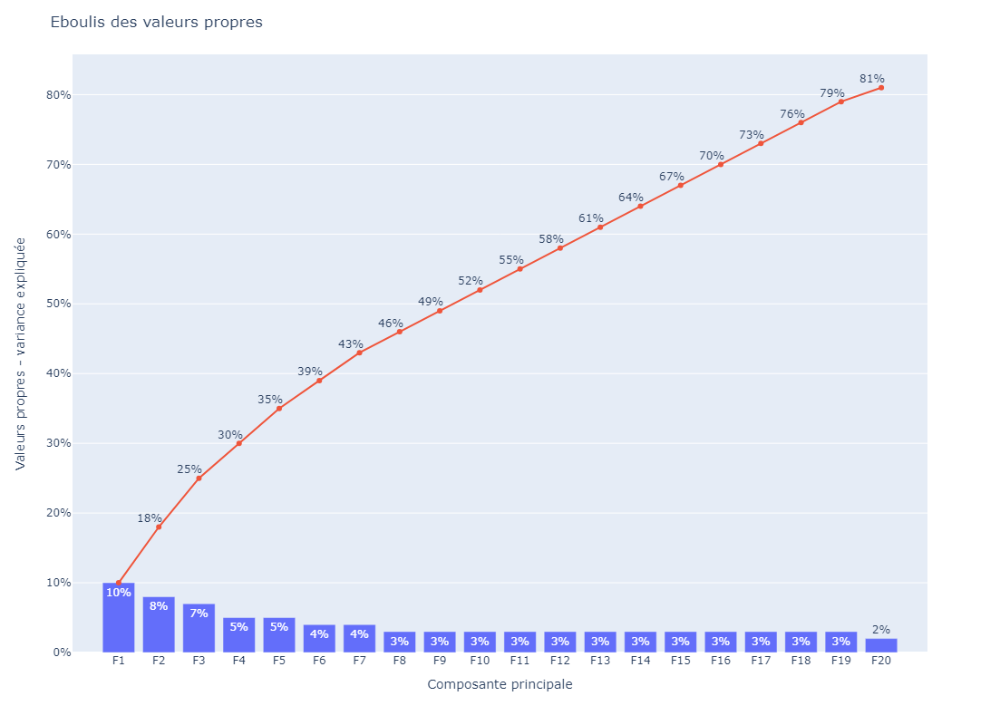

In [13]:
mf.PCA_scree_plot(dfPCA)

Comme anticipé l'ACP ne permet pas de capter facilement des tendances sur ce jeu de données ; la variance se répartit assez largement.

Regardons maintenant les correlations entres les variables initiales et chaque composante :

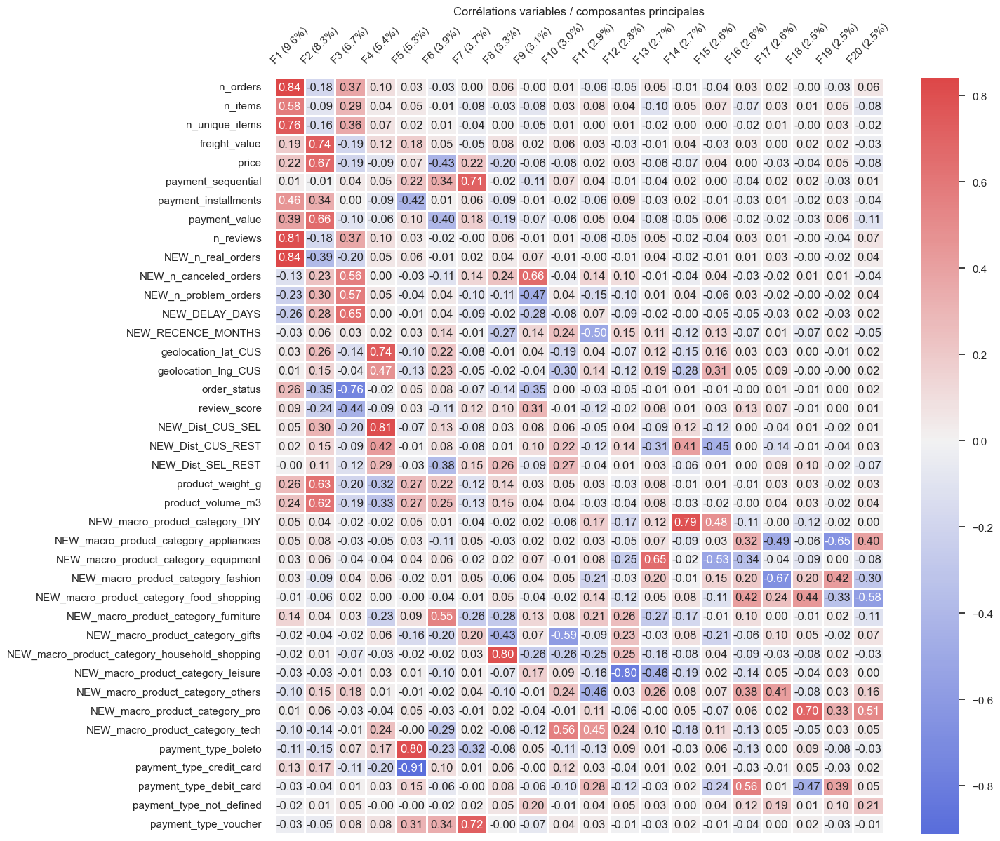

In [14]:
mf.heatPcaCorrelationMatrix(
    dfPCA, Xfeatures, additionnalVariable=None, figsize=(14, 14)
)

Nous n'allons pas analyser chaque composante, mais nous pouvons retenir quelques informations :
- la composante `F1` est liée au nombre de commandes, à la **fréquence** d'achat
- les composantes `F2` et `F6` sont liées au prix au sens large, au **montant**
- la composante `F3` est liée au **décalage de livraison**, au **statut** ainsi qu'à la **note client**
- la composante `F4` est liée à l'éloignement des clients. Ces informations seraient très intéressantes dans le cadre d'un travail sur l'optimisation de la logistique (ce qui n'est pas l'objet ici) ou encore pour adapter la communication à des particularités locales (ici les données ne concernent que le Brésil)
- les composantes `F8`, `F10` et `F11` sont assez liées à la **récence**.

Nous retouvons les thèmes classiques de la segmentation RFM. Nous réaliserons dans un premier temps une segmentation sur cette base :

# 2) RFM

Nous allons dans un premier temps utiliser une approche classique RFM : <br>
- Récence : temps écoulé depuis le dernier achat du client
- Fréquence : nombre d'achats effectués sur la période de l'étude
- Montant : la sommes des achats effectués sur la période de l'étude

Pour obtenir ces données clients, nous devons agréger notre dataset des commandes sur les `customer_unique_id` :

## 2.1) Agréger le dataset Commandes sur les `customer_unique_id`

Nous utliserons les colonnes suivantes :
- `NEW_RECENCE_MONTHS` : agrégation par le **minimum** pour obtenir `R` <br>
*Pour les clients ayant passé plus d'une commande, nous sélectionnons ainsi la plus récente.*
- `order_id` : agrégation par la **somme** pour obtenir `F` <br>
- `payment_value` : agrégation par la **somme** pour obtenir `M`

In [15]:
# agg dictionnary
aggDict = {
    "NEW_RECENCE_MONTHS": ["min"],
    "order_id": ["count"],
    "payment_value": ["sum"],
}

# use .groupby
RFM = dataOrd.groupby("customer_unique_id", as_index=False, observed=True).agg(aggDict)

# correct columns index
RFM.columns = pd.Index(e[0] for e in RFM.columns)

RFM.rename(
    columns={
        "NEW_RECENCE_MONTHS": "R",
        "order_id": "F",
        "payment_value": "M",
    },
    inplace=True,
)

# drop "customer_unique_id"
RFM.drop(columns="customer_unique_id", inplace=True)

## 2.2) Gestion des outliers

Regardons les caractéristiques de nos 3 features :

In [16]:
# use custom function myDescribe
mf.myDescribe(RFM)

Output()

`M` et `F` ont des outliers, regardons cela de plus près :

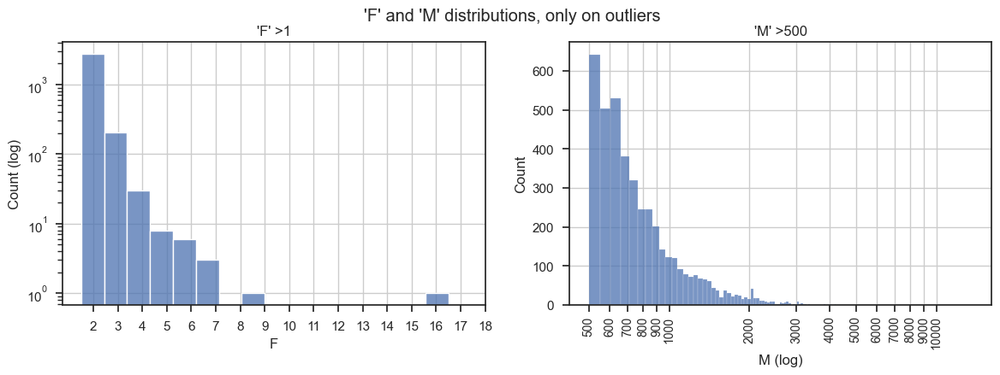

In [17]:
## plot "F" and "M" distributions with focus on outliers

sns.set_theme(style="ticks")
# create a figure and 2 axes
fig, (axF, axM) = plt.subplots(1, 2, figsize=(14, 4))

## "F"
# histplot
sns.histplot(data=RFM.loc[RFM["F"] > 1], x="F", bins=16, ax=axF)

# change axis, ticks for x axis, and logscale for y axis
xticks = np.arange(2, 19)
axF.set_xticks(xticks + 0.5)
axF.set_xticklabels(xticks)

axF.set_yscale("log")
axF.set_ylabel("Count (log)")


## "M"
# hisplot
sns.histplot(data=RFM.loc[RFM["M"] > 500], x="M", bins="auto", ax=axM)

# change x axis, logscale and rotate 90° ticklabels
axM.set_xscale("log")
xticks = list(np.arange(500, 1000, step=100)) + list(np.arange(1000, 10001, step=1000))
axM.set_xticks(xticks)
axM.set_xticklabels(xticks, rotation=90, fontsize=10, va="center_baseline")
axM.set_xlabel("M (log)")

## titles and grids
plt.suptitle("'F' and 'M' distributions, only on outliers")
axF.set_title("'F' >1")
axM.set_title("'M' >500")
axM.grid(True)
axF.grid(True)

sns.set_theme(style="whitegrid")

`F` : il n'y a que très peu de clients ayant acheté plus de 3 fois. <br>
`M` : idem pour les clients ayant dépensé plus de 1000 Réal. <br><br>
Nous faisons le choix de borner ces features :

In [18]:
# clip "M" with 1000 and "F" with 3
RFM["M"] = RFM["M"].clip(None, 1000)
RFM["F"] = RFM["F"].clip(None, 3)

# 3) RFM + Kmeans

## 3.1) Tests pour différents `scaler` et valeurs de `n_clusters`

Nous avons pour l'instant seulement trois features. Nous pouvons donc représenter encore facilement l'espace et appliquer notre algorithme.

Nous utiliserons la function `plot_scaling_and_Kmeans_3D_WID` qui permet de tester l'algorithme `KMeans` pour différents nombres de clusters et différents scalers :

In [19]:
mf.plot_scaling_and_Kmeans_3D_WID(dataframe=RFM, palette=clusterPalette)

Output()

Ce que l'on peut en retenir :
- le scaling des données a une influence importante sur le clustering :
    - sans scaling, la segmentation se réalise seulement selon `M`
    - avec le `RobustScaler`, le comportement est le même que sans scaling pour des k faibles, puis parvient à "capturer" R
    - avec le `SandardScaler`, les **3 features sont prises en compte**
 
Au niveau du nombre de clusters, cela commence à devenir intéressant à partir de 3 clusters, avec la **récence** prise en compte pour les clients ayant réalisé une unique commande (la grande majorité).

A partir de 4 clusters, le **montant** commence à être pris en compte également.

Pour 5 clusters, la segmentation devient plus fine sur la **récense**, ce qui n'apporte pas nécessairement de valeur ajoutée au clustering.

## 3.2) Conforter le choix de `n_clusters` : métriques d'évaluation et méthode du coude

Afin de nous aider à faire notre choix, nous allons utiliser la **méthode du coude**, qui consiste à calculer pour différentes valeurs de **k** une métrique d'évaluation du clustering, puis à sélectionner la valeur de **k au delà de laquelle la métrique n'évolue plus significativement dans le bon sens**.

Commençons pas *standardiser* `RFM` :

In [20]:
# create a scaled version of RFM
scaler = StandardScaler()

RFM_scaled = pd.DataFrame(scaler.fit_transform(RFM), columns=RFM.columns)

RFM_scaled.head()

,R,F,M
0,-0.835382,-0.173643,-0.102413
1,-0.815556,-0.173643,-0.789906
2,1.942246,-0.173643,-0.436120
3,0.532615,-0.173643,-0.691436
4,0.318494,-0.173643,0.227160


Puis appliquons la fonction `myElbowVisualizer`, qui permet de tracer différents graphiques :
- **DISTORTION Score Elbow** : C'est le graphique classique de la méthode du coude, qui utilise la ***distorsion*** correspondant à l'***inertie intra-classe*** (normalisée par n) des clusters
- **SILHOUETTE Score Elbow** : Ce graphique utilise la moyenne des coefficients de ***silhouette***.<br>
Le coefficient de silouette d'un point permet de quantifier :
    - le fait qu'il soit proche des autres points de son cluster
    - le fait qu'il soit éloigné des points des autres clusters
- **CALINSKI-HARABASZ Score Elbow** : avec l'indice de ***Calinski-Harabasz*** qui utilise la rapport entre l'***inertie intra-classe*** et l'***inertie inter-classe***

CPU times: total: 0 ns
Wall time: 101 ms


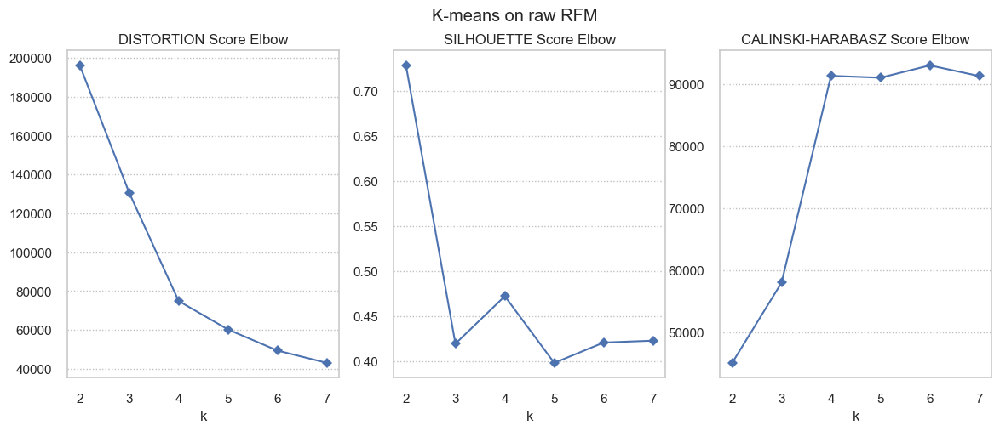

In [21]:
%%time
if "elbowViz_RFM_kmeans.joblib" not in os.listdir("mySaves/elbowViz") or (
    rapidProcessing == False
):
    elbowViz_RFM_kmeans = mf.myElbowVisualizer(
        model=KMeans(n_init=15),
        kRange=(2, 7),
        df=RFM_scaled,
        modelName="K-means on raw RFM",
    )

    dump(elbowViz_RFM_kmeans, "mySaves/elbowViz/elbowViz_RFM_kmeans.joblib")

else:
    elbowViz_RFM_kmeans = load("mySaves/elbowViz/elbowViz_RFM_kmeans.joblib")

Ces graphiques confirment notre impression : le nombre de 4 clusters semble être le plus adéquat.

In [22]:
# create a model with selected number of clusters
kmeans = KMeans(n_init=15, n_clusters=4)
# fit on RFM_scaled
kmeans.fit(RFM_scaled)
# extract cluter labels avec put them in a Series
kmeans_clusters = kmeans.predict(RFM_scaled)
kmeans_clusters = pd.Categorical(kmeans_clusters)
kmeans_clusters = pd.Series(kmeans_clusters, name="cluster")
# add to RFM
RFM_kmeans = pd.concat([RFM, kmeans_clusters], axis=1)

## 3.3) Évaluer notre clustering : métriques

Nous allons calculer nos métriques `coefficient de Silhouette moyen` et `indice de Calinski-Harabasz`. Nous rajouterons également l'`indice de Davies Bouldin` qui permet de comparer l'homogénéité des clusters à la séparation des clusters.

Nous allons placer les résultats dans un tableau :

In [23]:
# create a table to store "Silhouette","Calinski-H" and "Davies-Bouldin" metrics results

# create a dataframe
RFM_evaluate = pd.DataFrame(columns=["Silhouette", "Calinski-H", "Davies-Bouldin"])

if "KMeans_on_RFM.joblib" not in os.listdir("mySaves/evalMetrics") or (
    rapidProcessing == False
):
    # add metrics scores
    RFM_evaluate.loc["KMeans on RFM"] = [
        round(metric(RFM_scaled, kmeans_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(RFM_evaluate.loc["KMeans on RFM"], "mySaves/evalMetrics/KMeans_on_RFM.joblib")

else:
    RFM_evaluate.loc["KMeans on RFM"] = load("mySaves/evalMetrics/KMeans_on_RFM.joblib")

In [24]:
RFM_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFM,0.47,91287.94,0.68


## 3.4) Évaluer notre clustering : Silhouette plot

Afin d'évaluer notre clustering, traçons maintenant un **"silhouette plot"**, qui consiste à **tracer chaque coefficient de silhouette**, à les regrouper **par cluster** et à les **classer** par ordre croissant. Cela a pour effet de **tracer pour chaque cluster une "lame"** :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\sklearn\base.py:465: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



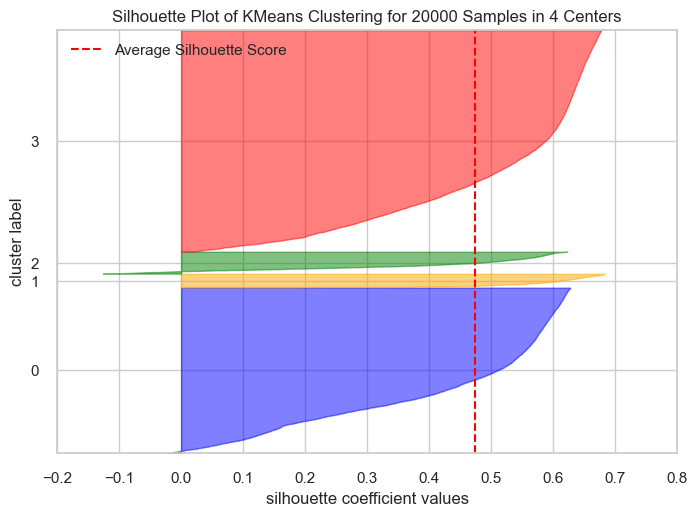

CPU times: total: 29.7 s
Wall time: 11.4 s


In [25]:
%%time
# use yellowbrick SilhouetteVisualizer

# create a visualizer
silhouetteViz_RFM_kmeans = SilhouetteVisualizer(
    estimator=kmeans,
    colors=list(clusterPalette.values()),
    is_fitted=True,
    # show=False,
)

# fit on a sample of 20000 from RFM_scaled
silhouetteViz_RFM_kmeans.fit(RFM_scaled.sample(20000))

# show
silhouetteViz_RFM_kmeans.finalize()
plt.show()

Nous pouvons interpréter ce graphique :
- chaque "lame" est plus grande que le coefficient de silhouette moyen, ce qui indique qu'**il n'y a pas de cluster incohérent**
- les "lames" sont d'épaisseurs différentes, indiquant des **tailles de cluster hétérogènes**
- les "lames" **fluctuent à peu près de la même manière** (la largeur entre la plus haute valeur de coefficient de silhouette et la plus basse).

## 3.5) Évaluer notre clustering : interprétabilité des clusters

Utilisons la fonction `clusteringRadarPlot` pour explorer chaque cluster en **calculant la moyenne** de **chaque feature** `R`, `F` et `M` pour **chaque cluster** :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



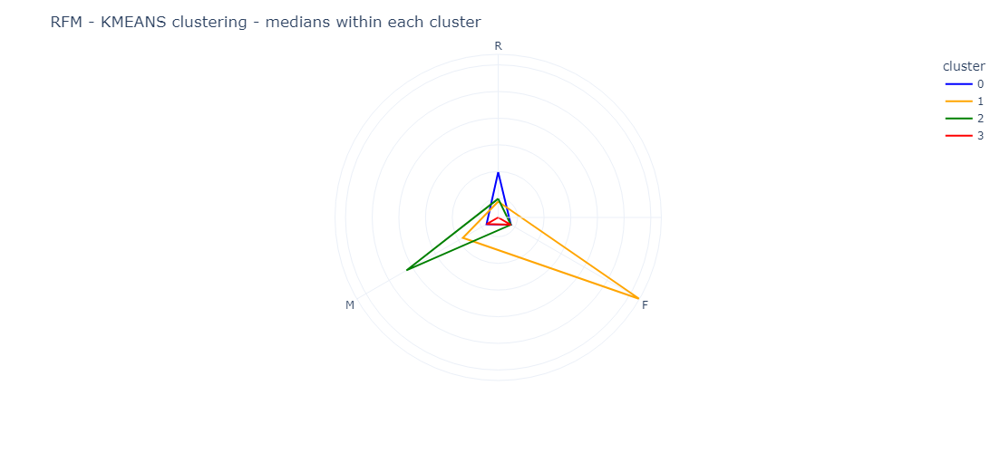

In [26]:
# use clusteringRadarPlot to compute the mean of each features by cluster and plot them on a radar plot
mf.clusteringRadarPlot(
    df=RFM,
    df_scaled=RFM_scaled,
    clusters=kmeans_clusters,
    func="mean",
    palette=clusterPalette,
    title="RFM - KMEANS clustering - medians within each cluster",
)

Utilisons `exploreClusters` pour continuer l'exploration de notre segmentation. Cette fonction permet d'afficher :
- la proportion de chaque cluster sur un "pie plot"
- pour chaque feature :
    - un **box plot** pour analyser sa **distribution générale**
    - un **box plot par cluster** pour analyser l'éventuel **impact du clustering sur sa distribution**
    - un **'100% stacked' bar plot** pour analyser la **proportion de chaque cluster pour différentes valeurs** de la feature étudiée

In [27]:
# use exploreClustersWID
mf.exploreClustersWID(
    df=RFM_kmeans,
    clusterName="cluster",
    clusteringModelName="Kmeans on RFM",
    palette=clusterPalette,
)

RadioButtons(description='Feature : ', options=('R', 'F', 'M'), style=DescriptionStyle(description_width='init…

Output()

Enfin, pour nous aider à comprendre et interpréter nos clusters, nous pouvons utiliser la fonction `plotFeatureVsTargetWID`. Cette fonction a été créée initialement pour des problèmes de classification, mais est assez bien adaptée à notre analyse.

Elle **permet de tracer la distribution d'une feature avec ou sans prise en compte de la Target (ici, ce seront nos labels de clustering)** :

In [28]:
mf.plotFeatureVsTargetWID(
    df=RFM_kmeans, targetFeatureName="cluster", palette=clusterPalette
)

Dropdown(description='Which column :', options=('R', 'F', 'M'), style=DescriptionStyle(description_width='init…

IntSlider(value=50, description="Nb of unique values below which a num' feature is considered cat' :", layout=…

Output()

Ce que l'on peut retenir de ces analyses :
Les clusters sont **facilement interprétables**, nous pouvons ainsi séparer nos clients en 4 catégories.

***"dépensiers"***<br>
- *Profil* : Ils n'ont réalisé qu'une seule commande, mais on dépensé en moyenne 700 réals pour celle-ci.<br>
- *Potentiel* : Ces clients ont un **potentiel très intéressant** pour l'entreprise car ils n'ont pas peur de dépenser beaucoup sur la plateforme. <br>
- *Objectif* : gagner leur confiance, déclencher une deuxième commande. <br>
- *Actions potentielles* :
    - offrir un (gros) bon d'achat
    - offrir un (gros) cadeau de bienvenue
    - inviter à des "ventes privées" sur des produits à valeur marchande élevée

***"récurrents"***
- *Profil* : Ont réalisé plusieurs commandes. Pour des montants variés.<br>
- *Potentiel* : Ces clients **sont déjà les plus intéressants**. Peuvent devenir des fidèles. <br>
- *Objectif* : entretenir la confiance. <br>
- *Actions potentielles* :
    - rechercher leurs catégories de produit préférées
    - inviter à des "ventes privées" sur les catégories de produits les plus achetées
    - proposer un dispositif "fidélité"
 
***"ex-clients"***
- *Profil* : Ils n'ont réalisé qu'une seule commande pour un montant modeste, il y a longtemps.<br>
- *Potentiel* : Ces client n'ont pas vraiment de potentiel, car le coût nécessaire pour les ré-intégrer serait élevé par rapport à la probabilité qu'ils commandent à nouveau. <br>
- *Objectif* : sans objet. Il faut peut-être accepter de perdre ces clients. <br>
- *Actions potentielles* : sans objet

***"nouveaux clients"***
- *Profil* : Ils n'ont réalisé qu'une seule commande pour un montant modeste, mais il y a peu de temps.<br>
- *Potentiel* : Ces clients ont du potentiel pour l'entreprise si l'on parvient à déclencher de nouvelles commandes. <br>
- *Objectif* : gagner leur confiance, déclencher une deuxième commande. <br>
- *Actions potentielles* : 
    - offrir un bon d'achat
    - offrir un cadeau de bienvenue

# 4) RFM  + Clustering hiérarchique

## 4.1) Difficultés d'utilisation

Essayons maintenant un autre modèle de clustering : le clustering hiérarchique.

Cet algorithme ayant la particularité d'être fortement consommateur en temps de calcul et en mémoire, **nous n'avons pas réussi à le faire converger** en utilisant tous les clients à notre disposition.

Afin de pouvoir le tester tout en utilisant le matériel à notre disposition, nous avons **diminué le nombre de points**.

## 4.2) "Échantillonnage" avec Kmeans

Nous prendrons un échantillon d'une taille correspondant à **10%** de nos clients, et **pour que cet échantillon soit représentatif**, nous ne prendrons **pas de vraies observations** mais nous les **simulerons grâce à l'algorithme KMeans** avec `n_clusters` = 10% N.

L'idée est de diminuer la taille du dataset tout en conservant sa structure grâce en quelque sorte à une *"diminution de la définition"*.

In [29]:
%%time
# do a "sampling-like" of RFM thanks to KMeans

if "RFM_scaled_10percent.joblib" not in os.listdir("mySaves/aggloClust") or (
    rapidProcessing == False
):
    ## define the size of final dataframe

    # percent of data
    percent = 10
    # compute the number of cluster_centers/samples
    n = int(RFM.shape[0] * percent / 100)

    ## create a KMeans model
    KmeansForSampling = KMeans(n_clusters=n)

    # fit
    KmeansForSampling.fit(RFM_scaled)

    # create "samples" with KmeansForSampling cluster_centers_
    RFM_scaled_10percent = pd.DataFrame(
        KmeansForSampling.cluster_centers_, columns=RFM_scaled.columns
    )

    # save
    dump(RFM_scaled_10percent, "mySaves/aggloClust/RFM_scaled_10percent.joblib")

else:
    RFM_scaled_10percent = load("mySaves/aggloClust/RFM_scaled_10percent.joblib")

CPU times: total: 0 ns
Wall time: 12.6 ms


## 4.3) Clustering hiérarchique sur notre "Échantillon"

Maintenant que nous avons notre "échantillon" de 10%, nous pouvons tester le clustering hiérarchique. Traçons tout d'abord le **dendrogramme** :

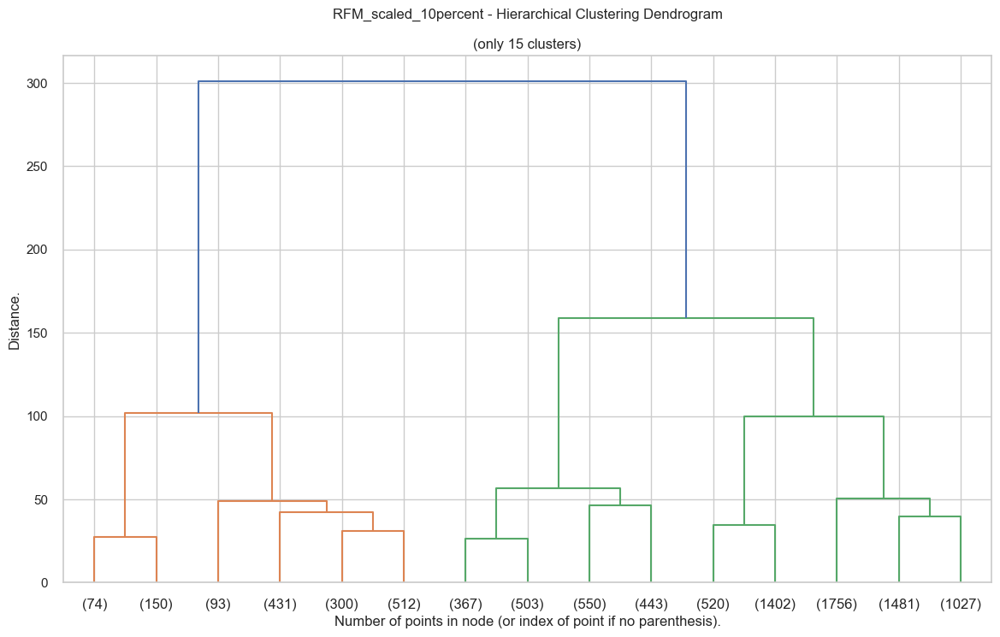

In [30]:
## agglomerative clustering dendrogram

## compute linkage
RFM_link = linkage(RFM_scaled_10percent, method="ward")

## create dendrogram
# create a figure
fig, ax = plt.subplots(1, 1, figsize=(14, 8))
# create dendrogram
dendrogram(Z=RFM_link, truncate_mode="lastp", p=15, ax=ax)


plt.title(
    "RFM_scaled_10percent - Hierarchical Clustering Dendrogram\n \n(only 15 clusters)"
)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.ylabel("Distance.")
plt.show()

Le dendrogramme nous incite à sélectionner 2 clusters... Il s'agit de la seule fois où la distance entre les clusters se distingue.

Cela reste pertinent pour 3, 4 ou 5.

Mais nous pouvons également utiliser la même méthode que pour le KMeans avec `myElbowVisualizer` :

CPU times: total: 0 ns
Wall time: 65.2 ms


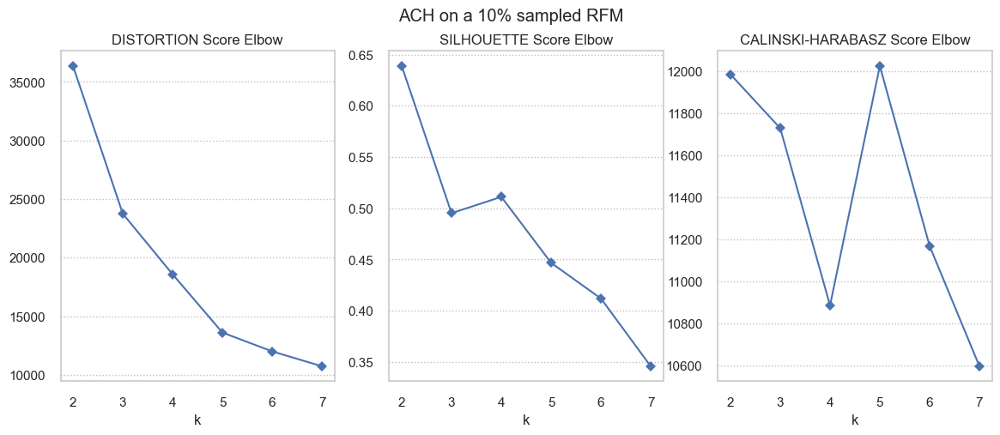

In [31]:
%%time
if "elbowViz_RFM_ach.joblib" not in os.listdir("mySaves/elbowViz") or (
    rapidProcessing == False
):
    elbowViz_RFM_ach = mf.myElbowVisualizer(
        model=AgglomerativeClustering(),
        kRange=(2, 7),
        df=RFM_scaled_10percent,
        modelName="ACH on a 10% sampled RFM",
    )

    dump(elbowViz_RFM_ach, "mySaves/elbowViz/elbowViz_RFM_ach.joblib")

else:
    elbowViz_RFM_ach = load("mySaves/elbowViz/elbowViz_RFM_ach.joblib")

On voit que le nombre de 5 clusters serait le plus intéressant pour notre dataset `RFM_scaled_10percent` :

In [32]:
%%time
agglo = AgglomerativeClustering(n_clusters=5)


# extract cluter labels avec put them in a Series
agglo_clusters = agglo.fit_predict(RFM_scaled_10percent)
agglo_clusters = pd.Categorical(agglo_clusters)
agglo_clusters = pd.Series(agglo_clusters, name="cluster")
# add to RFM
RFM_scaled_10percent_agglo = pd.concat([RFM_scaled_10percent, agglo_clusters], axis=1)

CPU times: total: 500 ms
Wall time: 2.27 s


## 4.3) Évaluer notre clustering : représentation 3D

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



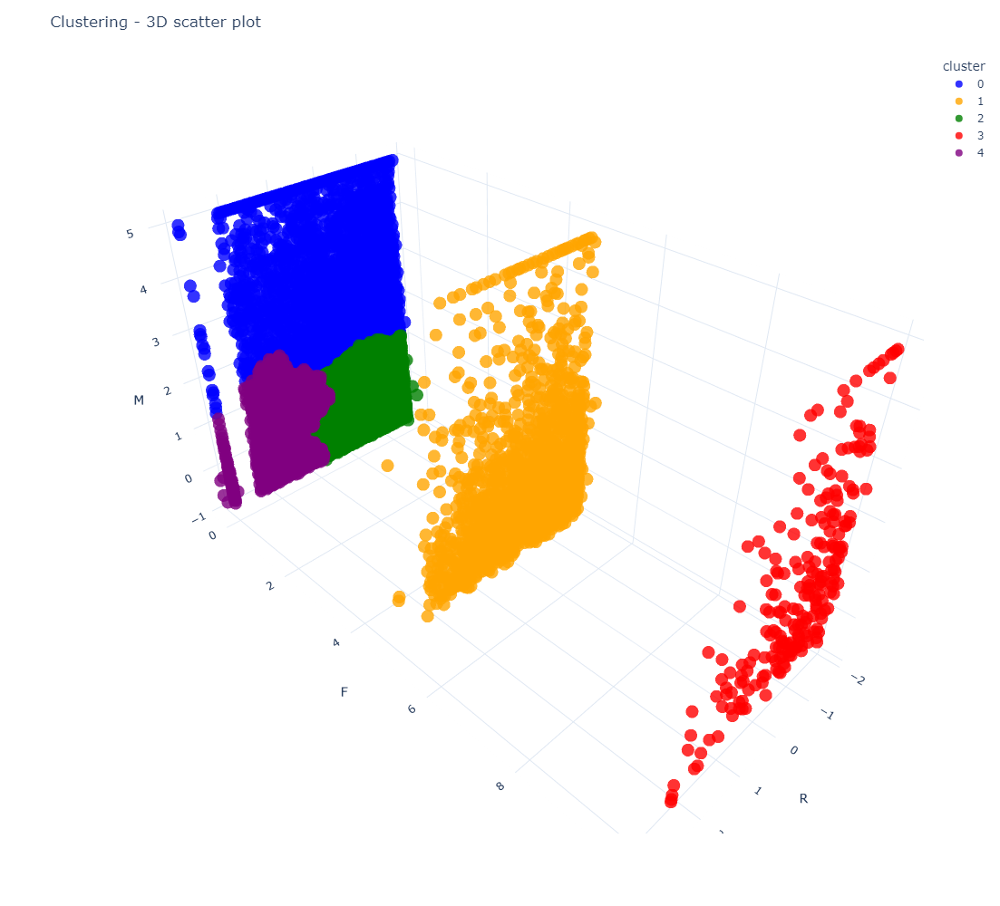

In [33]:
mf.clusters_plot3D(RFM_scaled_10percent_agglo, palette=clusterPalette)

Ce clustering se rapproche de celui obtenu avec KMeans. Il différe néanmoins :
- la limite entre entre les 2 clusters **"nouveaux clients"** et **"ex-clients"** semble différente
- le cluster des clients **"récurrents"** est séparée entre les clients ayant passé 2 commandes et les clients en ayant passé 3 ou plus.

Nous n'irons pas jusqu'au bout de l'interprétation de nos clusters, car le clustering n'est pas exhaustif.

## 4.4) Évaluer notre clustering : métriques

Nous pouvons tout de même ajouter nos métriques :

In [34]:
# add metrics to our table
if "ACH_on_RFM_10_percent.joblib" not in os.listdir("mySaves/evalMetrics") or (
    rapidProcessing == False
):
    # add metrics scores
    RFM_evaluate.loc["ACH on RFM 10 percent"] = [
        round(metric(RFM_scaled_10percent, agglo_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["ACH on RFM 10 percent"],
        "mySaves/evalMetrics/ACH_on_RFM_10_percent.joblib",
    )

else:
    RFM_evaluate.loc["ACH on RFM 10 percent"] = load(
        "mySaves/evalMetrics/ACH_on_RFM_10_percent.joblib"
    )

In [35]:
RFM_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFM,0.47,91287.94,0.68
ACH on RFM 10 percent,0.45,12023.80,0.71


A noter que le `Calinski-Harabasz Index` ne peut pas être comparé au précédent, car il est dépend en partie de la taille de l'échantillon.

# 5) RFM + tSNE - Comprendre le manifold

Le comportement de notre dataset n'est pas linéaire, il pourrait donc être intéressant de rechercher le `manifold` de nos données afin d'utiliser notre algorithme de clustering de manière différente.

Nous allons utiliser le `tSNE` pour essayer de capturer le forme de nos données : 

## 5.1) Tests et choix de l'outil

Faisons un premier essai avec le `TSNE` proposé par la librairie `Scikit Learn` :

In [36]:
# create a pipeline to use the TSNE algorithm

# create a scaler
scaler = StandardScaler()

# create a TSNE with 2 components
tsne = TSNE(
    n_components=2,
    init="pca",
    metric="euclidean",
    n_jobs=16,
    random_state=16,
)

# put thme in a pipeline
pipeSklearn = Pipeline(steps=[("scaler", scaler), ("tsne", tsne)])

Faisons d'abord un essai avec la perplexité 30, de base dans l'algorithme.

In [37]:
%%time
if "test_RFM_tsne_30.joblib" not in os.listdir("mySaves/reductions") or (
    rapidProcessing == False
):
    # set perplexity to 30
    pipeSklearn.set_params(
        **{
            "tsne__perplexity": 30,
        }
    )

    # apply on RFM and put it in a dataframe
    test_RFM_tsne_30 = pd.DataFrame(
        data=pipeSklearn.fit_transform(RFM), columns=["C1", "C2"]
    )

    # save
    dump(test_RFM_tsne_30, "mySaves/reductions/test_RFM_tsne_30.joblib")

else:
    # load existing .joblib
    test_RFM_tsne_30 = load("mySaves/reductions/test_RFM_tsne_30.joblib")

CPU times: total: 0 ns
Wall time: 3 ms


CPU times: total: 35min 40s <br>
Wall time: 5min 36s

Le temps de calcul est assez long. Essayons une autre librairie, `openTSNE` :

In [38]:
# create a pipeline to use the openTSNE algorithm

# create a scaler
scaler = StandardScaler()

# create a open TSNE with 2 components
tsne = openTSNE(
    n_components=2,
    initialization="pca",
    metric="euclidean",
    n_jobs=16,
    random_state=16,
)

# put thme in a pipeline
pipeOpen = Pipeline(steps=[("scaler", scaler), ("tsne", tsne)])

In [39]:
%%time
if "test_RFM_openTsne_30.joblib" not in os.listdir("mySaves/reductions") or (
    rapidProcessing == False
):
    # set perplexity to 30
    pipeOpen.set_params(
        **{
            "tsne__perplexity": 30,
        }
    )

    # apply on RFM and put it in a dataframe
    test_RFM_openTsne_30 = pd.DataFrame(
        data=pipeOpen.fit_transform(RFM.values), columns=["C1", "C2"]
    )

    # save
    dump(test_RFM_openTsne_30, "mySaves/reductions/test_RFM_openTsne_30.joblib")

else:
    # load existing .joblib
    test_RFM_openTsne_30 = load("mySaves/reductions/test_RFM_openTsne_30.joblib")

CPU times: total: 0 ns
Wall time: 4 ms


CPU times: total: 13min 50s <br>
Wall time: 3min 49s

Le temps de calcul est meilleur, comparons maintenant les résultats visuellement :

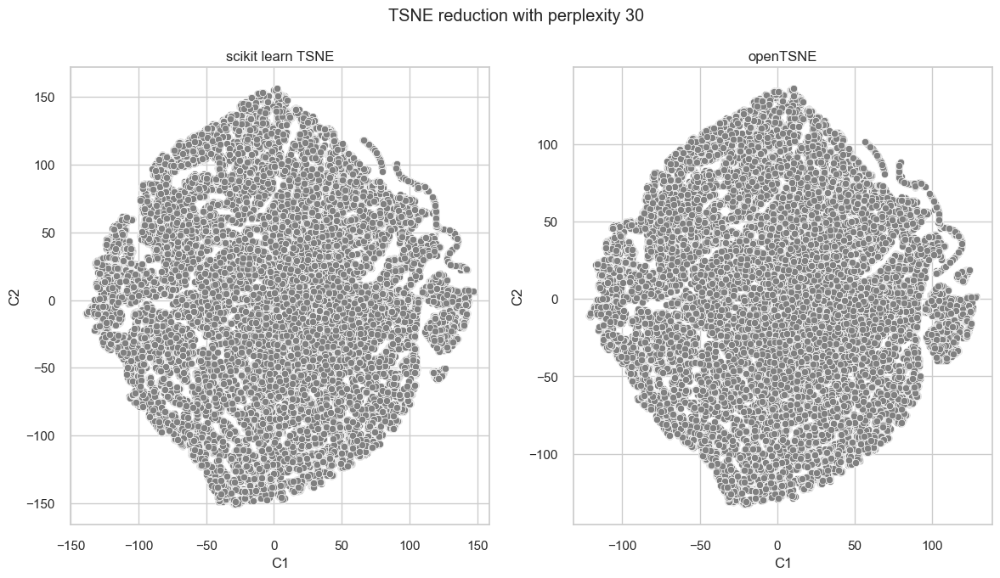

In [40]:
# 2 scatter plots to compare both TSNE algorithms

# create a figure
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))

# plot TSNE
sns.scatterplot(data=test_RFM_tsne_30, x="C1", y="C2", ax=ax1, c="grey")

# plot openTSNE
sns.scatterplot(data=test_RFM_openTsne_30, x="C1", y="C2", ax=ax2, c="grey")

# titles
plt.suptitle("TSNE reduction with perplexity 30")
ax1.set_title("scikit learn TSNE")
ax2.set_title("openTSNE")

# scale
ax1.axis("equal")
ax2.axis("equal")

plt.show()

Les résultats se rapprochent, nous utiliserons **openTSNE pour sa rapidité**.

## 5.2) Exploration des paramètres

`OpenTSNE` diffère de `Scikit Learn` au niveau de la documentation et des paramètres du TSNE :

**Documentation - Autres plages conseillées pour la `perplixity` :**<br>
`OpenTSNE` propose d'explorer des perplexités bien plus importantes (voir https://opentsne.readthedocs.io/en/stable/parameters.html#id6). En effet, pour une perplexité classiquement fixée à 30, l'algorithme cherche à conserver les distances avec les 30 plus proches voisins dans l'espace de projection. Ainsi intuitivement plus le nombre d'observations augmente, moins l'algorithme prendra en compte la structure globale. La documentation indique **par exemple qu'il est possible d'utiliser une perplexité de 500 pour un dataset de 10 000 points**. Nous n'irons pas jusque là car le temps de calcul deviendrait alors trop important.

Nota : un article (https://towardsdatascience.com/how-to-tune-hyperparameters-of-tsne-7c0596a18868) propose $perplexity = \sqrt{N}$. Ce qui pour notre cas reviendrait à utiliser une valeur de 310.<br><br>

**Paramètre - `Exaggeration` :**<br>
`OpenTSNE` introduit également un autre paramètre : l'`Exaggeration`.

Ce paramètre augmente "la force d'attraction" entre les points et a donc pour effet de :
- resserer les points proches
- éloigner les groupes de points les uns des autres

**Classiquement** l'exaggeration est utilisée **durant la phase initiale**, via le paramètre `early_exaggeration`, fixé habituellement à 12. **On "exagère" au début de l'algorithme, puis on repasse en mode normal par la suite**.

`OpenTSNE` permet également d'utiliser de l'`Exaggeration` durant la phase normale d'optimisation. **Selon la documentation :**
- Cela a pour effet d'**accroitre la densité** des groupes de points dans la projection finale.
- **Peut être utile pour un grand nombre de points**

Nous allons tester différents paramètres et enregistrer les résultats (car les calculs sont très longs) :

In [41]:
# perplexities to explore
perps = [30, 50, 100, 150, 200, 310]
# exaggerations to explore
exas = [None, 2]
# metrics to explore
metrics = ["euclidean", "cosine"]

In [42]:
%%time
# save tSNE tests in a dictionnary
if "RFM_tsne_Dict.joblib" not in os.listdir("mySaves/reductions") or (
    rapidProcessing == False
):
    # create dictionnary
    RFM_tsne_Dict = {}
    # iterate on perplexities, exaggerations and metrics
    for perp in perps:
        for exa in exas:
            for met in metrics:
                # apply parameters to or pipeline
                pipeOpen.set_params(
                    **{
                        "tsne__perplexity": perp,
                        "tsne__metric": met,
                        "tsne__exaggeration": exa,
                    }
                )
                # fit_transform on RFM and put it in a dataframe
                RFM_tsne_Dict[str(perp) + "_" + str(exa) + "_" + met] = pd.DataFrame(
                    data=pipeOpen.fit_transform(RFM), columns=["C1", "C2"]
                )
    # save
    dump(RFM_tsne_Dict, "mySaves/reductions/RFM_tsne_Dict.joblib")
else:
    RFM_tsne_Dict = load("mySaves/reductions/RFM_tsne_Dict.joblib")

CPU times: total: 0 ns
Wall time: 44.9 ms


Nous allons utiliser la fonction `plot_scaling_and_Kmeans_2D_WID` pour tester différentes valeurs de `n_clusters` sur une projection. Nous allons **tout d'abord l'adapter au dictionnaire que nous venons de créer**, ainsi nous pourrons tester différentes perplexités, métriques ou exagérations.

In [43]:
def showMeTsnesAndKmeans(tsneDict, perp, exa, metric, palette):
    """
    use the plot_scaling_and_Kmeans_2D_WID function on a value of a dictionnary containing TSNE embeddings
    parameters :
    ------------
    tsneDict - dictionnary of dataframes :
                                        - "perplexity_exaggeration_metric" as keys
                                        - 2D TSNE embeddings as values
    perp - int : perplexity value to look in keys
    exa - int : exaggeration value to look in keys
    metric - string : metric value to look in keys
    palette - dictionnary : clusters names as keys, colors as values

    output :
    --------
    displays a 2D scatter of selected embedding, with hue on clusters

    """
    # imports
    import pandas as pd
    import ipywidgets as widgets

    # recreate the key
    key = "_".join([perp, exa, metric])

    # use plot_scaling_and_Kmeans_2D_WID function on corresponding value
    mf.plot_scaling_and_Kmeans_2D_WID(tsneDict[key], palette=palette)

Utiliser `ipywidgets` pour sélectionner facilement les différentes projections comprises dans le dictionnaire :

In [44]:
def showMeTsnesAndKmeansWID(tsneDict, palette):
    """
    use the showMeTsnesAndKmeans function on a dictionnary containing TSNE embeddings, with options to select perplexity, exaggeration and metric
    parameters :
    ------------
    tsneDict - dictionnary of dataframes :
                                        - "perplexity_exaggeration_metric" as keys
                                        - 2D TSNE embeddings as values
    palette - dictionnary : clusters names as keys, colors as values

    output :
    --------
    displays a 2D scatter of selected embedding, with hue on clusters

    """
    # imports
    import pandas as pd
    import ipywidgets as widgets

    # widget to select perplexity
    widPerp = widgets.Dropdown(
        options=[str(perp) for perp in perps],
        description="Perplexity :",
        disabled=False,
    )

    # widget to select exaggeration
    widExa = widgets.Dropdown(
        options=[str(exa) for exa in exas], description="Exag :", disabled=False
    )

    # widget to select the metric
    widMetric = widgets.Dropdown(
        options=metrics, description="Metric :", disabled=False
    )

    # create a ui
    ui = widgets.HBox(
        [widPerp, widExa, widMetric],
        layout=widgets.Layout(justify_content="space-around"),
    )

    # use interactive_output on showMeTsnesAndKmeans function
    out = widgets.interactive_output(
        showMeTsnesAndKmeans,
        {
            "tsneDict": widgets.fixed(tsneDict),
            "perp": widPerp,
            "exa": widExa,
            "metric": widMetric,
            "palette": widgets.fixed(palette),
        },
    )

    display(ui, out)

Nous pouvons maintenant appliquer cette fonction à `RFM_tsne_Dict` :
- **explorer et observer** les **résultats de TSNE**, en jouant sur :
    - `perplexity`
    - `exaggeration`
    - `metric`
- appliquer **également KMeans** et jouer avec `n_clusters`

In [45]:
showMeTsnesAndKmeansWID(RFM_tsne_Dict, clusterPalette)

Output()

Ce que l'on peut en retenir :
- la `metric` "euclidean" semble **plus indiquée**
- au delà d'une `perplexity` de 100 (sans `exaggeration`), la représentation semble esquisser des séparations, mais l'algorithme `KMeans` **échoue à les retranscrire** et "capture" des observations de part et d'autre
- toujours pour ces mêmes `perplexity` élevées, l'ajout d'une `exaggeration` à 2 permet de bien séparer les groupes, mais `KMeans` **échoue là encore**

**Nous utiliserons donc la version du dataset avec :**
- `perplexity` = **100**
- `exaggeration` = **None**
- `metric` = **euclidean**

# 6) RFM + tSNE (*`perplexity`=100 / `exaggeration`=None*) + Kmeans

Sortons le tSNE sélectionné :

In [46]:
# extract the dataframe with perplexity 100, euclidean metric and exaggeration None
RFM_tsne = RFM_tsne_Dict["100_None_euclidean"].copy()

# scale it
scaler = StandardScaler()
RFM_tsne_scaled = pd.DataFrame(scaler.fit_transform(RFM_tsne), columns=RFM_tsne.columns)

## 6.1) Choix `n_clusters` : métriques d'évaluation et méthode du coude

Testons différentes valeurs de k avec nos métriques avec `myElbowVisualizer` :

CPU times: total: 15.6 ms
Wall time: 72.5 ms


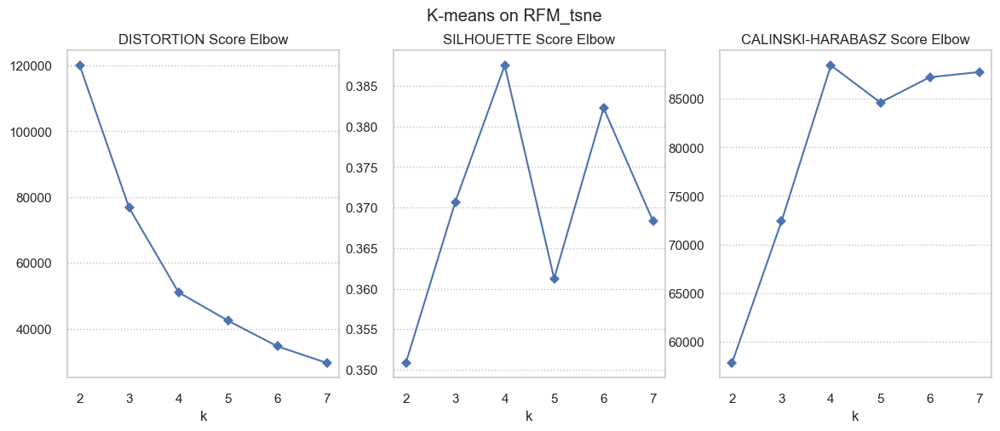

In [47]:
%%time
if "elbowViz_RFM_tsne_kmeans.joblib" not in os.listdir("mySaves/elbowViz") or (
    rapidProcessing == False
):
    # use myElbowVisualizer on RFM_tsne_scaled
    elbowViz_RFM_tsne_kmeans = mf.myElbowVisualizer(
        model=KMeans(n_init=15),
        kRange=(2, 7),
        df=RFM_tsne_scaled,
        modelName="K-means on RFM_tsne",
    )

    dump(elbowViz_RFM_tsne_kmeans, "mySaves/elbowViz/elbowViz_RFM_tsne_kmeans.joblib")

else:
    elbowViz_RFM_tsne_kmeans = load("mySaves/elbowViz/elbowViz_RFM_tsne_kmeans.joblib")

Le nombre de **4 clusters** semble être le plus pertinent :

In [48]:
# create a model with selected number of clusters
kmeans_tsne = KMeans(n_init=15, n_clusters=4)
# fit on RFM_tsne_scaled
kmeans_tsne.fit(RFM_tsne_scaled)
# extract cluster labels avec put them in a Series
kmeans_tsne_clusters = kmeans_tsne.predict(RFM_tsne_scaled)
kmeans_tsne_clusters = pd.Categorical(kmeans_tsne_clusters)
kmeans_tsne_clusters = pd.Series(kmeans_tsne_clusters, name="cluster")
# add to RFM_tsne_scaled
RFM_tsne_scaled_kmeans = pd.concat([RFM_tsne_scaled, kmeans_tsne_clusters], axis=1)

Nous pouvons tracer nos clusters dans l'espace de redescription et dans notre espace RFM :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



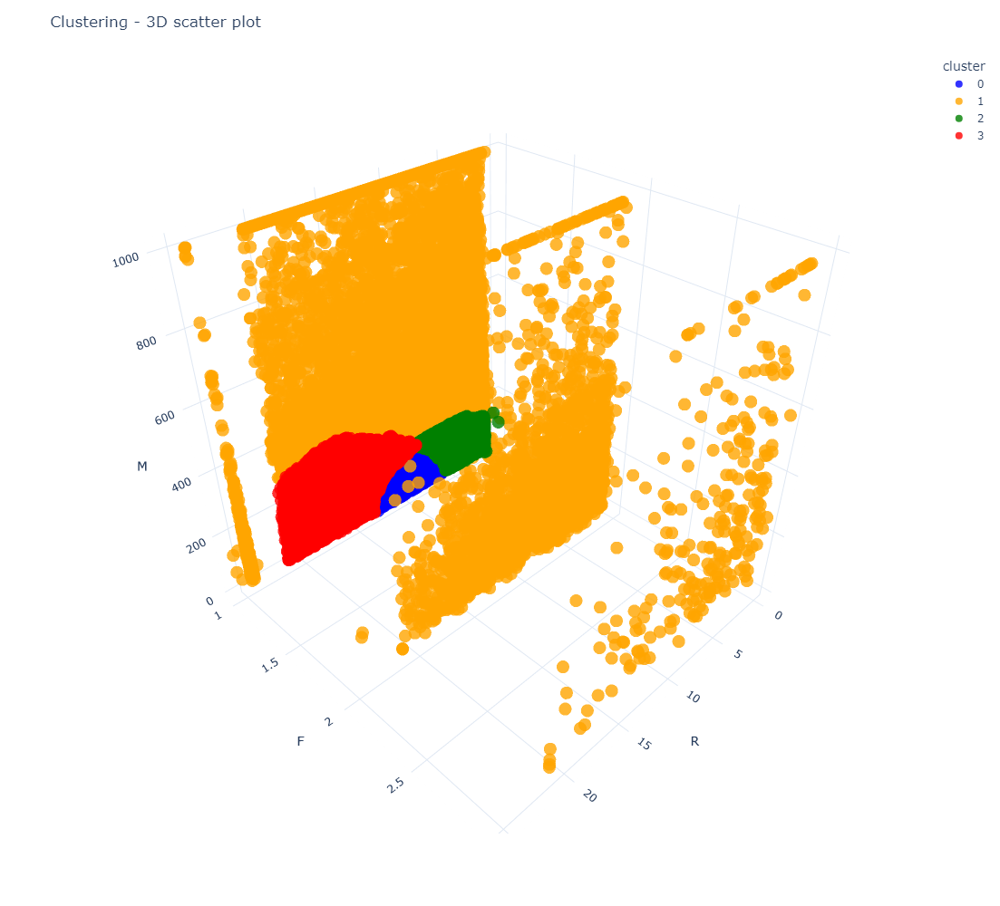

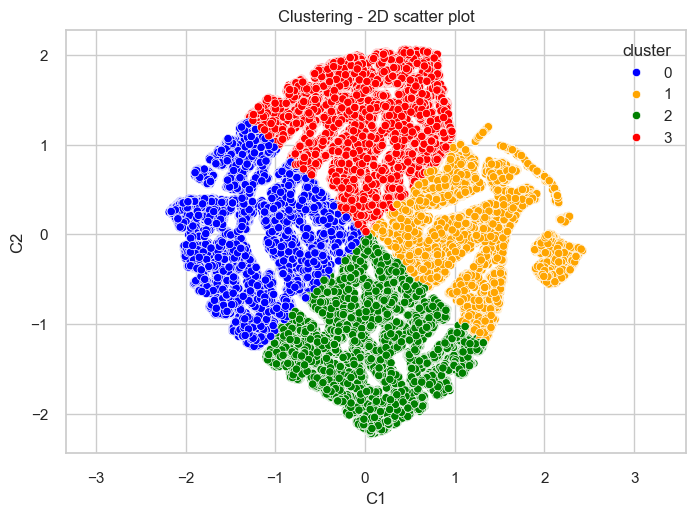

In [49]:
# plot 2D using RFM_tsne
mf.clusters_plot2D(dataframe=RFM_tsne_scaled_kmeans, palette=clusterPalette)

# plot 3D using RFM
# add clusters to RFM
RFM_and_kmeans_tsne = pd.concat([RFM, kmeans_tsne_clusters], axis=1)
mf.clusters_plot3D(dataframe=RFM_and_kmeans_tsne, palette=clusterPalette, sample=None)

Ce que l'on peut en retenir :
- Les clusters **"récurrents"** et **"dépensiers"** sont regroupés, ce qui pourrait faire sens car il s'agit des "meilleurs clients"
- Au lieu d'avoir 2 clusters sur l'axe `R`, nous en avons 3, ce qui n'est pas forcément indispensable sauf si l'on souhaite vraiment pour adapter les campagnes marketing :
    - **"nouveaux clients"**
    - **"futurs ex-clients"** : comprendre pourquoi ils n'ont pas passé d'autres commandes, petits bon d'achats, etc.
    - **"ex-clients"**

## 6.2) Évaluer notre clustering : métriques

Nous pouvons ajouter les métriques d'évaluation de nos clusters à notre tableau. Il faut néanmoins noter que comme notre **clustering a été réalisé à partir de la représentation tSNE**, il est **encore une fois difficile de le comparer** ...

Nous allons tout de même calculer nos métriques, et le faire **sur nos 2 espaces** :

In [50]:
# add this new clustering to RFM_evaluate table, first cumpute on RFM_tsne
if "KMeans_on_RFM_tsne_metrics_on_RFM_tsne.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM_tsne"] = [
        round(metric(RFM_tsne_scaled, kmeans_tsne_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM_tsne"],
        "mySaves/evalMetrics/KMeans_on_RFM_tsne_metrics_on_RFM_tsne.joblib",
    )

else:
    RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM_tsne"] = load(
        "mySaves/evalMetrics/KMeans_on_RFM_tsne_metrics_on_RFM_tsne.joblib"
    )


# then on RFM
if "KMeans_on_RFM_tsne_metrics_on_RFM.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM"] = [
        round(metric(RFM_scaled, kmeans_tsne_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM"],
        "mySaves/evalMetrics/KMeans_on_RFM_tsne_metrics_on_RFM.joblib",
    )

else:
    RFM_evaluate.loc["KMeans on RFM_tsne - metrics on RFM"] = load(
        "mySaves/evalMetrics/KMeans_on_RFM_tsne_metrics_on_RFM.joblib"
    )

In [51]:
RFM_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFM,0.47,91287.94,0.68
ACH on RFM 10 percent,0.45,12023.80,0.71
KMeans on RFM_tsne - metrics on RFM_tsne,0.39,88459.09,0.81
KMeans on RFM_tsne - metrics on RFM,0.26,22686.63,1.26


On voit que pour chaque indice/score, le résultat est meilleur sur l'espace de redescription, ce qui est logique car c'est dans cet espace que KMeans a travaillé.

## 6.3) Évaluer notre clustering : Silhouette plot et interprétabilité des clusters

De la même manière, notre silhouette plot peut effectivement être tracé directement sur l'espace de redescription `RFM_tsne` ...

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\sklearn\base.py:465: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



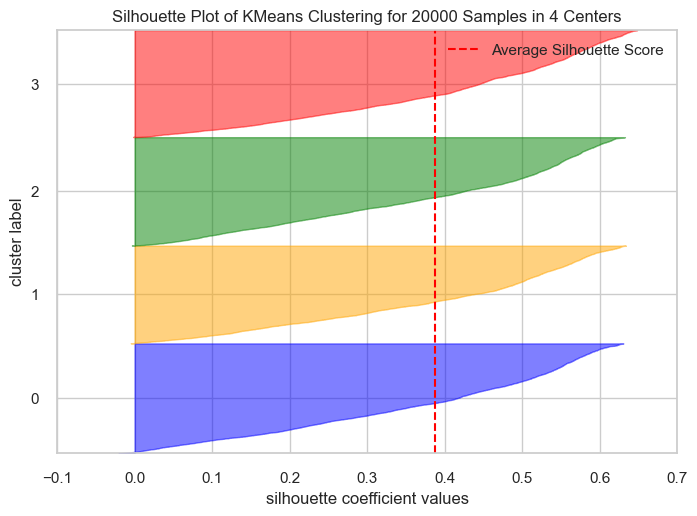

CPU times: total: 30.1 s
Wall time: 9.8 s


In [52]:
%%time
# use yellowbrick SilhouetteVisualizer

# create a visualizer
silhouetteViz_RFMtsne_kmeans = SilhouetteVisualizer(
    estimator=kmeans_tsne, colors=list(clusterPalette.values()), is_fitted=True
)

# fit on a sample of 20000 from RFM_tsne_scaled
silhouetteViz_RFMtsne_kmeans.fit(RFM_tsne_scaled.sample(20000))

# show
silhouetteViz_RFMtsne_kmeans.finalize()
plt.show()

Le clustering est **pertinent sur `RFM_tsne`** (chaque "lame" traverse la moyenne, les fluctuations sont homogènes, etc.).

Regardons maintenant ce que cela donne sur notre espace initial.

*Nota : pour cela nous devons adapter un peu la fonction `SilhouetteVisualizer` en utilisant la class `ContribEstimator` de `YellowBrick` :<br> https://www.scikit-yb.org/en/latest/api/contrib/wrapper.html*

*Cela nous permettra de tracer un silhouette plot :*
- *même si le modèle ne possède pas l'attribut `n_clusters`*
- *même si le modèle ne possède pas la méthode `.predict()`*
- *sur un autre espace que l'espace utilisé pour le fit (**notre cas ici**)*

In [53]:
# create a wrapper to add functionnalities to a clustering model

# imports
from yellowbrick.contrib.wrapper import ContribEstimator, CLUSTERER


# create a wrapper class
class MyWrapper(ContribEstimator):
    # set estimator type
    _estimator_type = CLUSTERER

    # if estimator does not have "n_clusters" property, add it
    @property
    def n_clusters(self):
        return len(np.unique(self.labels_))


# add or change .predict method
# use of .labels (therefore the model must be already fitted)
# use ".index", if a sample is used
def predict(cls, X):
    return cls.labels_[X.index]


MyWrapper.predict = predict

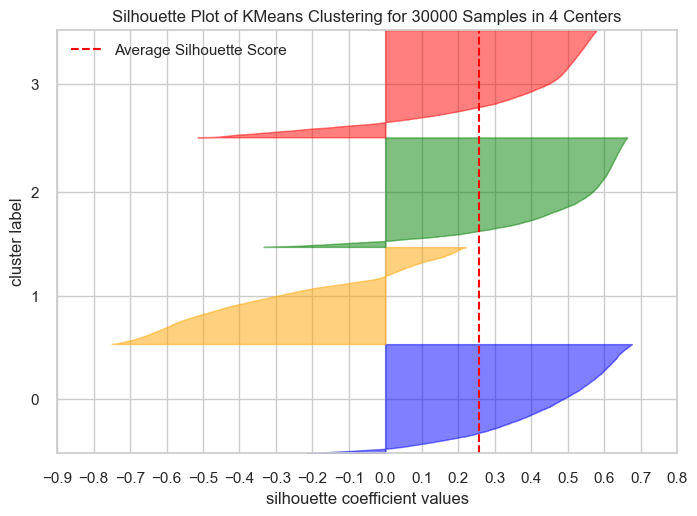

CPU times: total: 1min
Wall time: 21.4 s


In [54]:
%%time
# use yellowbrick SilhouetteVisualizer

# create a visualizer (use MyWrapper class for plotting in a different space)
silhouetteViz_RFMtsne_kmeansBIS = SilhouetteVisualizer(
    estimator=MyWrapper(kmeans_tsne),
    colors=list(clusterPalette.values()),
    is_fitted=True,
)

# fit on a sample of 30000 from RFM_tsne_scaled
silhouetteViz_RFMtsne_kmeansBIS.fit(RFM_scaled.sample(30000))

# show
silhouetteViz_RFMtsne_kmeansBIS.show()
plt.show()

Ce que l'ont peut en retenir :
- nous retrouvons le coefficient de silhouette moyen calculé dans notre tableau `RFM_evaluate`
- les **tailles de clusters sont homogènes**
- le cluster **"dépensiers"+"récurrents"** :
    - **dégrade** largement la configuration avec **énormément de coefficients <0**. Sa "lame" n'arrivant même pas à traverser la moyenne, pourtant basse
    - cela s'explique pour une petite partie par le fait qu'il **intègre des clients avec une `R` très élevée et un `M` très faible**. Ce qui est de plus **illogique** d'un point de vue marketing
- le cluster **"ex-clients"** est lui aussi problématique. Cela s'explique par le fait qu'il **intègre des clients avec une `R` moyenne mais un `M` plus élevé**, ce qui perturbe sa forme, **ce qui en soit ne serait pas un problème si l'interprétation suivait, mais l'inverse aurait été plus logique d'un point de vue marketing** : des clients avec une `R` moyenne mais un `M` **faible**.

Regardons maintenant ce que cela donne au niveau des moyennes par cluster :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



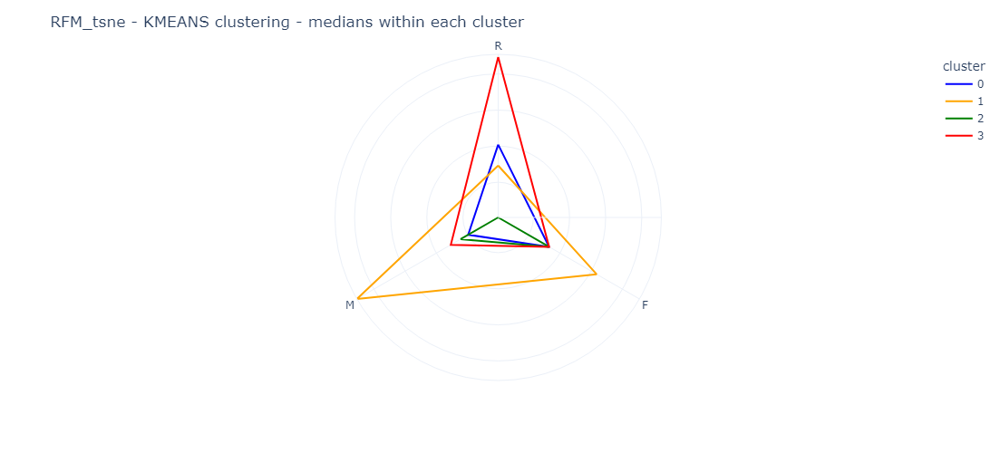

In [55]:
# use clusteringRadarPlot to compute the mean of each features by cluster and plot them on a radar plot
mf.clusteringRadarPlot(
    df=RFM,
    df_scaled=RFM_scaled,
    clusters=kmeans_tsne_clusters,
    func="mean",
    palette=clusterPalette,
    title="RFM_tsne - KMEANS clustering - medians within each cluster",
)

On retrouve la pertinence des clusters **"dépensiers"+"récurrents"** et **futurs ex-clients**. 

Regardons maintenant les distributions :

In [56]:
# use exploreClustersWID
mf.exploreClustersWID(
    df=RFM_and_kmeans_tsne,
    clusterName="cluster",
    clusteringModelName="Kmeans on RFM_tsne",
    palette=clusterPalette,
)

RadioButtons(description='Feature : ', options=('R', 'F', 'M'), style=DescriptionStyle(description_width='init…

Output()

In [57]:
mf.plotFeatureVsTargetWID(
    df=RFM_and_kmeans_tsne, targetFeatureName="cluster", palette=clusterPalette
)

Dropdown(description='Which column :', options=('R', 'F', 'M'), style=DescriptionStyle(description_width='init…

IntSlider(value=50, description="Nb of unique values below which a num' feature is considered cat' :", layout=…

Output()

On retrouve :
- la pertinence des clusters **"dépensiers"+"récurrents"** et **futurs ex-clients**
- le problème du cluster **futurs ex-clients** qui **intègre des clients avec une `R` moyenne et un `M` plus élevé**
- le problème du cluster **"dépensiers"+"récurrents"** qui **intègre des clients avec une `R` très élevée et un `M` très bas**

# 7) RFM + tSNE (*`perplexity`=100 / `exaggeration`=None*) + DBSCAN

Essayons un autre algorithme de clustering sur l'espace de redescription : le `DBSCAN`.

## 7.1) Tests pour différents `scaler` et valeurs de `epsilon` et `nmin`

In [58]:
mf.plot_scaling_and_DBSCAN_2D_WID(dataframe=RFM_tsne_scaled, palette=clusterPalette)

Output()

L'algorithme `DBSCAN` ne semble pas adapté à notre problème. En effet il n'y a pas vraiment de fluctuation en terme de densité sur notre projection issue du `tSNE`. L'algorithme a donc tendance à vouloir :
- pour des valeurs de `eps` **faibles** (par exemple pour des valeurs au dessus de 0.1) avec `nmin` **élevée** (par exemple au dessus de 500): considérer touts les points comme du bruit
- à `eps` constant (par exemple = 0.1), faire **diminuer** `nmin` permet petit à petit de créer des clusters, mais trop jusqu'à `nmin` < 200-150
- à `nmin` constant (par exemple = 500), faire **augmenter** `epsilon` permet petit à petit de créer des clusters, mais peu, toujours avec du bruit

Les **paramètres `eps` = 0.1 et `nmin` = 150**, qui au moins ne laissent pas d'observations sans cluster (-1), produisent 6 clusters, **mais sans discriminer la grande zone centrale, qui ne semble pas comporter de réelle fluctuation de densité...**

In [59]:
%%time
# create a model with selected eps and nmin
db_tsne = DBSCAN(eps=0.1, min_samples=150, n_jobs=14)
# fit_predict on RFM_tsne_scaled and put these labels in a Series
db_tsne_clusters = db_tsne.fit_predict(RFM_tsne_scaled)
db_tsne_clusters = pd.Categorical(db_tsne_clusters)
db_tsne_clusters = pd.Series(db_tsne_clusters, name="cluster")
# add to RFM_tsne_scaled
RFM_tsne_scaled_dbscan = pd.concat([RFM_tsne_scaled, db_tsne_clusters], axis=1)

CPU times: total: 8.78 s
Wall time: 1.32 s


## 7.2) Évaluer notre clustering : métriques

Même principe que précédemment : Nous allons tout de même calculer nos métriques, et le faire **sur nos 2 espaces** :

In [60]:
# add this new clustering to RFM_evaluate table, first cumpute on RFM_tsne
if "DBSCAN_on_RFM_tsne_metrics_on_RFM_tsne.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM_tsne"] = [
        round(metric(RFM_tsne_scaled, db_tsne_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM_tsne"],
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_metrics_on_RFM_tsne.joblib",
    )

else:
    RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM_tsne"] = load(
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_metrics_on_RFM_tsne.joblib"
    )


# then on RFM
if "DBSCAN_on_RFM_tsne_metrics_on_RFM.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM"] = [
        round(metric(RFM_scaled, db_tsne_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM"],
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_metrics_on_RFM.joblib",
    )

else:
    RFM_evaluate.loc["DBSCAN on RFM_tsne - metrics on RFM"] = load(
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_metrics_on_RFM.joblib"
    )

In [61]:
RFM_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFM,0.47,91287.94,0.68
ACH on RFM 10 percent,0.45,12023.80,0.71
KMeans on RFM_tsne - metrics on RFM_tsne,0.39,88459.09,0.81
KMeans on RFM_tsne - metrics on RFM,0.26,22686.63,1.26
DBSCAN on RFM_tsne - metrics on RFM_tsne,-0.17,2511.08,0.69
DBSCAN on RFM_tsne - metrics on RFM,-0.20,16312.35,0.86


Ce que l'on peut en retenir :
- pour le **Silhouette score** :
    - **négatif** dans les deux cas
    - nous n'avons pas encore regardé sur l'espace initial `RFM`, **mais rien que sur l'espace `RFM_tsne`**, si l'on prend le **cas du cluster très allongé**, des coefficients de Silhouette mauvais peuvent s'expliquer car c'est une **forme non convexe**.<br>
- pour **Calinski-H**, sur l'espace `RFM_tsne` :
    -  les clusters sont majoritairement très petits et proches
    -  l'un est très grand, un autre est très allongé
    Cela ne participe pas à l'amélioration de cet indice.
- pour l'indice de **Davies-Bouldin**, sur l'espace `RFM_tsne` : idem

**D'une manière générale, le type de cluster découvert n'est pas vraiment adapté à ces métriques d'évaluation...**

## 7.3) Évaluer notre clustering : tracer sur l'espace initiale `RFM`

Voyons ce que cela donne dans l'espace initial `RFM` : 

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



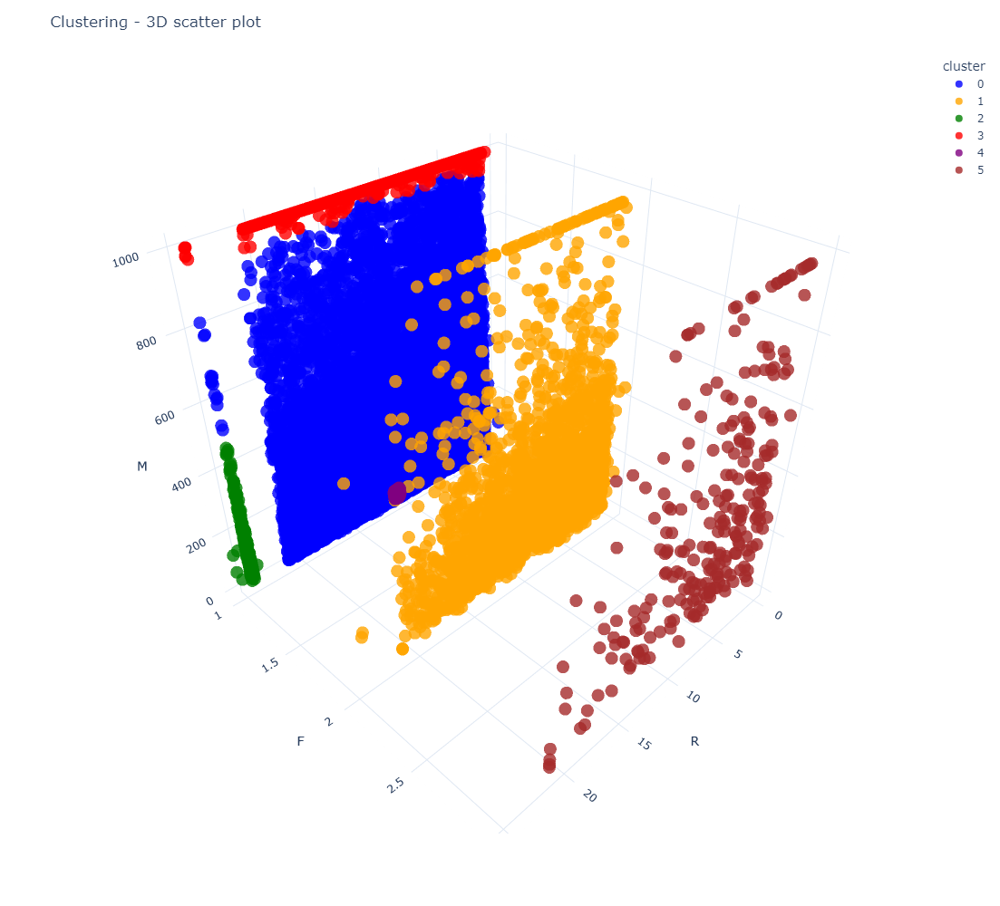

In [62]:
# plot 3D
# add clusters to RFM
RFM_and_dbscan_tsne = pd.concat([RFM, db_tsne_clusters], axis=1)
mf.clusters_plot3D(dataframe=RFM_and_dbscan_tsne, palette=clusterPalette, sample=None)

Ce clustering n'est pas exploitable d'un point de vue marketing :
- la presque totalité des clients sont regroupés au sein d'un même cluster
- **cette grande zone avec `F`=1** n'a été séparé qu'à trois endroits :
    - pour les clients **très très anciens**, car il y a **un gap entre `R`=21 et `R`=24**, gap qui s'est **retranscrit sur le t-SNE**.
    - pour les clients **très dépensiers**, car il y a **un saut de densité sur `M`** à cet endroit (qui s'est **retranscrit sur le t-SNE**). De plus **ce saut a été créé artificiellement lors du traitement des outliers...**
    - pour des clients autour de **`R`=10**, car il y a peut-être une fluctuation de densité...

Ce type de clustering n'est pas vraiment adapté. En effet la grande majorité des clients n'ont passé qu'une commmande (`F`=1), et il n'y a pas vraiment de variation de densité sur `R` et `M` dans cette zone...

**Nous ne tracerons pas les autres graphiques, ce clustering n'étant pas très concluant.**

Voyons si nous ne pouvons pas utiliser cet algorithme d'une autre manière ... grâce à d'autres paramètres du `t-SNE` :

# 8) RFM + tSNE (*`perplexity`=$\sqrt{N}$ / `exaggeration`=2*) + DBSCAN

Nous avons vu tout à l'heure que **pour de plus grandes valeurs de `perplexity` et grâce à de l'`exaggeration`**, `TSNE` parvenait **"visuellement" à bien séparer des groupes**. Cette **configuration a beaucoup plus de sens pour un algorithme à densité** : 

In [63]:
# extract the dataframe with perplexity 310, euclidean metric and exaggeration 2
RFM_tsne_BIS = RFM_tsne_Dict["310_2_euclidean"].copy()

# scale it
scaler = StandardScaler()
RFM_tsne_BIS_scaled = pd.DataFrame(
    scaler.fit_transform(RFM_tsne_BIS), columns=RFM_tsne_BIS.columns
)

## 8.1) Tests pour différents `scaler` et valeurs de `epsilon` et `nmin`

Testons différents paramètres `epsilon` et `nmin` :

In [64]:
# use plot_scaling_and_DBSCAN_2D_WID
mf.plot_scaling_and_DBSCAN_2D_WID(dataframe=RFM_tsne_BIS, palette=clusterPalette)

Output()

Ce que l'on peut en retenir :
- un **`nmin` trop élevé** à tendance à classer en **"bruit" les 2 petits groupes** de points isolés. A partir de 250 le problème semble être réglé.
- Nous **ne trouvons pas** de réglage de `epsilon` et `nmin` **permettant de capturer les clients isolés au haut à doite sans pour autant laisser séparée la forme en bas au centre**...
- En revanche **pour un `epsilon` > 0.19**, les clients isolés à côté du groupe de droite **peuvent lui être rattaché**.

Utilisons les paramètres esp = 0.2 et nmin = 200, qui semblent capturer les différentes zones :

In [65]:
# create a model with selected eps and nmin
db_tsne_BIS = DBSCAN(eps=0.2, min_samples=200, n_jobs=14)
# fit_predict on RFM_tsne_scaled and put these labels in a Series
db_tsne_BIS_clusters = db_tsne_BIS.fit_predict(RFM_tsne_BIS_scaled)
db_tsne_BIS_clusters = pd.Categorical(db_tsne_BIS_clusters)
db_tsne_BIS_clusters = pd.Series(db_tsne_BIS_clusters, name="cluster")
# add to RFM_tsne_BIS_scaled
RFM_tsne_BIS_scaled_and_dbscan = pd.concat(
    [RFM_tsne_BIS_scaled, db_tsne_BIS_clusters], axis=1
)

## 8.2) Évaluer notre clustering : métriques

Métriques **sur nos 2 espaces** :

In [66]:
# add this new clustering to RFM_evaluate table, first cumpute on RFM_tsne_BIS
if "DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM_tsne_BIS.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM_tsne_BIS"] = [
        round(metric(RFM_tsne_BIS_scaled, db_tsne_BIS_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM_tsne_BIS"],
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM_tsne_BIS.joblib",
    )

else:
    RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM_tsne_BIS"] = load(
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM_tsne_BIS.joblib"
    )


# then on RFM
if "DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM.joblib" not in os.listdir(
    "mySaves/evalMetrics"
) or (rapidProcessing == False):
    # add metrics scores
    RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM"] = [
        round(metric(RFM_scaled, db_tsne_BIS_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM"],
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM.joblib",
    )

else:
    RFM_evaluate.loc["DBSCAN on RFM_tsne_BIS - metrics on RFM"] = load(
        "mySaves/evalMetrics/DBSCAN_on_RFM_tsne_BIS_metrics_on_RFM.joblib"
    )

In [67]:
RFM_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFM,0.47,91287.94,0.68
ACH on RFM 10 percent,0.45,12023.80,0.71
KMeans on RFM_tsne - metrics on RFM_tsne,0.39,88459.09,0.81
KMeans on RFM_tsne - metrics on RFM,0.26,22686.63,1.26
DBSCAN on RFM_tsne - metrics on RFM_tsne,-0.17,2511.08,0.69
DBSCAN on RFM_tsne - metrics on RFM,-0.20,16312.35,0.86
DBSCAN on RFM_tsne_BIS - metrics on RFM_tsne_BIS,0.26,38510.56,0.84
DBSCAN on RFM_tsne_BIS - metrics on RFM,0.22,33157.17,1.02


Sur le même principe, même sur l'espace de redescription `RFM_tsne_BIS` le métriques ne sont pas très bonnes. Celles-ci ne sont pas très adaptées à ce type de cluster.

## 8.3) Évaluer notre clustering : tracer sur l'espace initiale `RFM`

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



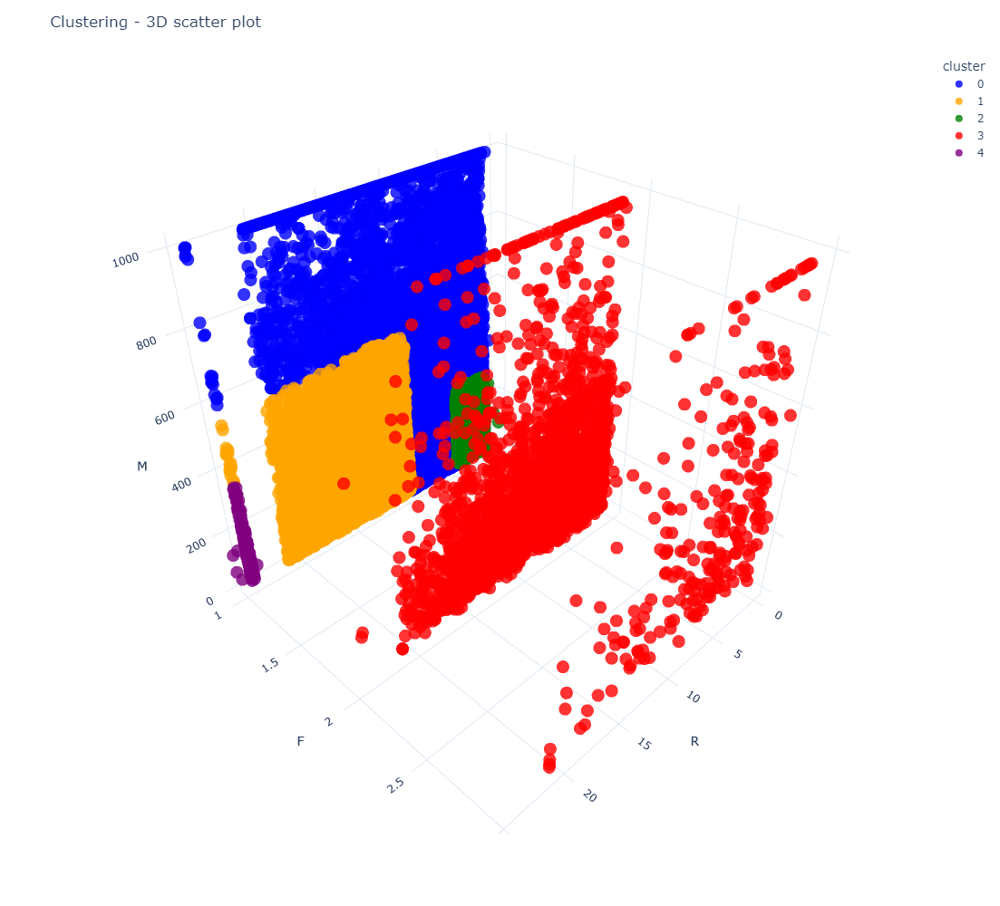

In [68]:
# plot 3D
# add clusters to RFM
# plot
RFM_and_dbscan_tsne_BIS = pd.concat([RFM, db_tsne_BIS_clusters], axis=1)
mf.clusters_plot3D(
    dataframe=RFM_and_dbscan_tsne_BIS, palette=clusterPalette, sample=None
)

Ce que l'on peut en retenir :
- nous retrouvons les **"récurrents"** ainsi que les **"nouveaux clients"**
- les clients isolés que nous n'avons pas réussi à ré-introduire dans un grand cluster sont en fait des clients avec `R` très grand : la grande zone voisine était donc le cluster des **"ex-clients"**. Disposer d'un cluster supplémentaire des clients très très anciens n'a pas beaucoup de sens.
- nous n'avons plus vraiment de cluster avec `F`=1 et `M` très élevé : des clients avec `M` faible ont été ratachés ...
- le cluster ainsi créé n'a plus beaucoup de sens d'un point de vu marketing : les clients avec `M` faible n'ont pas beaucoup de points communs avec les autres clients du groupe.

**Nous ne tracerons pas les autres graphiques, ce clustering n'étant pas très concluant.**

# 9) RFMDR

Nous allons rajouter `DELAY` et `review_score` à nos features.

La prise en compte du **niveau de satisfaction** et des **éventuels retards de livraison** apportera **du sens** à notre segmentation et permettra un ciblage marketing **plus fin**.

De plus, lors de l'étude initiale sur le choix des features nous avions remarqué que la 3ème composante était correlée avec le `DELAY` et le `review_score`. Ces features sont donc peut-être aussi pertinentes d'un point du vue purement technique, car elles apportent de la variance.

## 9.1) Agréger le dataset Commandes sur les `customer_unique_id`

In [69]:
## aggregation  1, for raw dataset

# agg dictionnary
aggDict1 = {
    "NEW_RECENCE_MONTHS": ["min"],
    # 'NEW_delivered': ["sum"],
    "order_id": ["count"],
    "payment_value": ["sum"],
    "NEW_DELAY_DAYS": ["mean"],
}

# use .groupby
df1 = dataOrd.groupby("customer_unique_id", as_index=False, observed=True).agg(aggDict1)

# correct columns index
df1.columns = pd.Index(e[0] for e in df1.columns)

df1.rename(
    columns={
        "NEW_RECENCE_MONTHS": "R",
        # "NEW_delivered":"F",
        "order_id": "F",
        "payment_value": "M",
        "NEW_DELAY_DAYS": "DELAY",
    },
    inplace=True,
)

# drop "customer_unique_id"
df1.drop(columns="customer_unique_id", inplace=True)


## aggregation  2, for datset sorted by 'order_purchase_timestamp'

# agg dictionnary
aggDict2 = {
    "review_score": ["first"],
}

# use .groupby, but first sort by 'order_purchase_timestamp'
df2 = (
    dataOrd.sort_values("order_purchase_timestamp", ascending=False)
    .groupby("customer_unique_id", as_index=False, observed=True)
    .agg(aggDict2)
)

# correct columns index
df2.columns = pd.Index(e[0] for e in df2.columns)

# drop "customer_unique_id"
df2.drop(columns="customer_unique_id", inplace=True)


## concat
RFMDR = pd.concat([df1, df2], axis=1)

Regardons les caractéristiques de nos 5 features :

In [70]:
mf.myDescribe(RFMDR)

Output()

Nous avons toujours les mêmes types d'outliers pour `R`, `F` et `M`. Les outliers de `DELAY` ont déjà été gérés lors de sa création.

## 9.2) Gestion des outliers et des types

In [71]:
# clip "M" with 1000
RFMDR["M"] = RFMDR["M"].clip(None, 1000)

# clip "F" with 3
RFMDR["F"] = RFMDR["F"].clip(None, 3)

# clip "F" with 3
RFMDR["F"] = RFMDR["F"].clip(None, 3)

In [72]:
# change "review_score" dtype
RFMDR["review_score"] = RFMDR["review_score"].astype("f")

In [73]:
# create a scaled version
scaler = StandardScaler()
RFMDR_scaled = pd.DataFrame(scaler.fit_transform(RFMDR), columns=RFMDR.columns)

# 10) RFMDR + Kmeans

## 10.1) Tests pour différents `scaler` et valeurs de `n_clusters`

Testons différents paramètres. Cette fois nous ne pouvons plus représenter le clustering en 3D, nous utiliserons donc un `pairgrid plot` qui nous permettra de représenter notre espace 5D en 10 graphiques 2D (la partie basse) ainsi que chaque distribution (la diagonale) :

In [74]:
# use plot_scaling_and_Kmeans_pairGrid_WID function to plot
mf.plot_scaling_and_Kmeans_pairGrid_WID(
    dataframe=RFMDR, palette=clusterPalette, title="RFM + DELAY + REVIEW SCORE - Kmeans"
)

Output()

Ce que l'on peut en retenir :
- nous retiendrons encore une fois le `StandardScaler`, pour les même raisons que précédemment.
- pour l'ancien paramétrage **`n_clusters` = 4** :
    - nous conservons des clusters de type **"récurrents"**, **"nouveaux"** et **"ex"**
    - mais le cluster **"dépensiers"** a disparu
    - le 4ème cluster comprend maintenant des clients **"mécontents et/ou ayant subi un retard"** :
        - Ces clients sont pour la plupart mécontents (**s'ils ne le sont pas, ils ont subi un retard très important**)
        - Ces clients ont pour la plupart subi un retard de livraison (**si ce n'est pas le cas, ils sont mécontents**)
    - il apparait donc pertinent d'explorer d'autres paramètres.
- **`n_clusters` = 5** :
    - le cluster **"dépensiers"** réapparait !
- **`n_clusters` = 6** :
    - ici le cluster **"mécontents"** se sépare
    - d'un côté les **"mécontents sans retard ou avec un retard faible de livraison"**
    - de l'autre les **"mécontents avec un retard important de livraison"**
      <br>Cette séparation **ne permettrait pas vraiment de différencier la stratégie marketing pour ces clients**...

## 10.2) Conforter le choix de `n_clusters` : métriques d'évaluation et méthode du coude

Regardons ce que cela donne avec `myElbowVisualizer` :

CPU times: total: 0 ns
Wall time: 81.6 ms


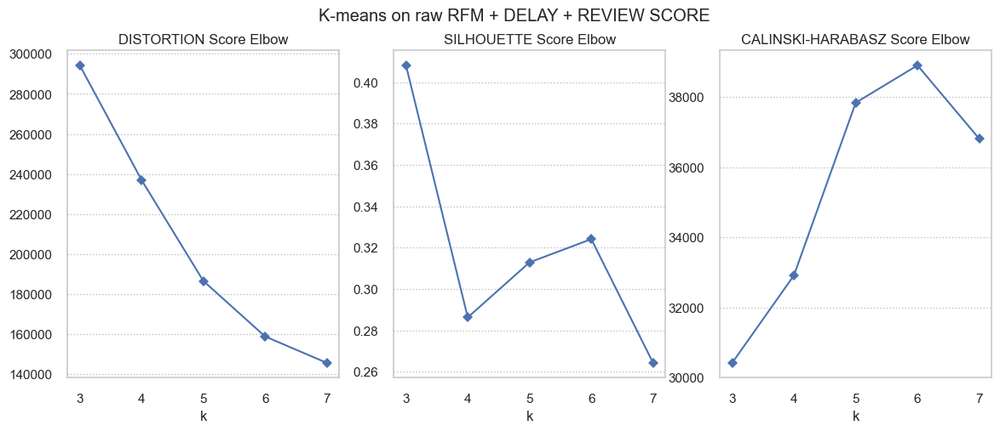

In [75]:
%%time
if "elbowViz_RFMDR_kmeans.joblib" not in os.listdir("mySaves/elbowViz") or (
    rapidProcessing == False
):
    elbowViz_RFMDR_kmeans = mf.myElbowVisualizer(
        model=KMeans(n_init=15),
        kRange=(3, 7),
        df=RFMDR_scaled,
        modelName="K-means on raw RFM + DELAY + REVIEW SCORE",
    )

    dump(elbowViz_RFMDR_kmeans, "mySaves/elbowViz/elbowViz_RFMDR_kmeans.joblib")

else:
    elbowViz_RFM_plus_kmeans = load("mySaves/elbowViz/elbowViz_RFMDR_kmeans.joblib")

D'un point de vue technique le nombre de clusters qui se distingue légérement est 5 :
- légère cassure au niveau de la `distortion` et du coefficient de `silhouette`
- cassure plus marquée pour le `calinski-harabasz`
  <br>(une cassure plus marquée que la distorsion indique que l’inertie interclasse profite moins du passage de 5 à 6 clusters que l’inertie intra classe)


In [76]:
# create a model with selected number of clusters
kmeans_RFMDR = KMeans(n_init=15, n_clusters=5)
# fit on RFMDR_scaled
kmeans_RFMDR.fit(RFMDR_scaled)
# extract cluter labels avec put them in a Series
kmeans_RFMDR_clusters = kmeans_RFMDR.predict(RFMDR_scaled)
kmeans_RFMDR_clusters = pd.Categorical(kmeans_RFMDR_clusters)
kmeans_RFMDR_clusters = pd.Series(kmeans_RFMDR_clusters, name="cluster")
# add to RFMDR
RFMDR_kmeans = pd.concat([RFMDR, kmeans_RFMDR_clusters], axis=1)

## 10.3) Évaluer notre clustering : métriques

Créons un nouveau tableau pour stocker les scores obtnues sur nos métriques d'évaluation :

In [77]:
# create a new table to store "Silhouette","Calinski-H" and "Davies-Bouldin" metrics results

# create a dataframe
RFMDR_evaluate = pd.DataFrame(columns=["Silhouette", "Calinski-H", "Davies-Bouldin"])

if "KMeans_on_RFMDR.joblib" not in os.listdir("mySaves/evalMetrics") or (
    rapidProcessing == False
):
    # add metrics scores
    RFMDR_evaluate.loc["KMeans on RFMDR"] = [
        round(metric(RFMDR_scaled, kmeans_RFMDR_clusters), 2)
        for metric in [silhouette_score, calinski_harabasz_score, davies_bouldin_score]
    ]

    dump(
        RFMDR_evaluate.loc["KMeans on RFMDR"],
        "mySaves/evalMetrics/KMeans_on_RFMDR.joblib",
    )

else:
    RFMDR_evaluate.loc["KMeans on RFMDR"] = load(
        "mySaves/evalMetrics/KMeans_on_RFMDR.joblib"
    )

In [78]:
RFMDR_evaluate

,Silhouette,Calinski-H,Davies-Bouldin
KMeans on RFMDR,0.32,38907.9,0.96


## 10.4) Évaluer notre clustering : Silhouette plot

Traçons maintenant le **"silhouette plot"** :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\sklearn\base.py:465: UserWarning:

X does not have valid feature names, but KMeans was fitted with feature names



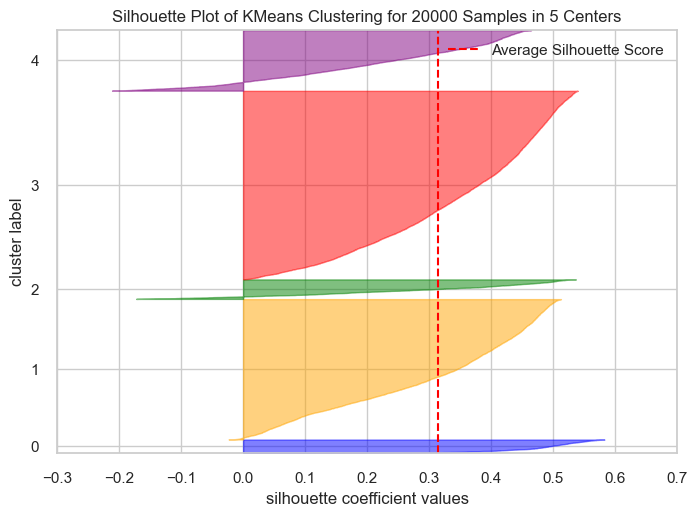

CPU times: total: 19 s
Wall time: 9.08 s


In [79]:
%%time
# use yellowbrick SilhouetteVisualizer

# create a visualizer
silhouetteViz_RFMDR_kmeans = SilhouetteVisualizer(
    estimator=kmeans_RFMDR, colors=list(clusterPalette.values()), is_fitted=True
)

# fit on a sample of 20000 from RFMDR_scaled
silhouetteViz_RFMDR_kmeans.fit(RFMDR_scaled.sample(20000))

# show
silhouetteViz_RFMDR_kmeans.finalize()
plt.show()

Ce que l'ont peut en retenir :
- les clusters ont **toujours des tailles hétérogènes**
- nos "lames" **traversent bien toutes** le coefficient de Silhouette moyen
- en revanche la **fluctuation est importante**.

## 10.5) Évaluer notre clustering : interprétabilité des clusters

Traçons de nouveau les graphiques nous permettant d'interpréter notre clustering.<br>
Le Pairgrid plot :

In [80]:
# use clusters_plotPairGrid_WID function
mf.clusters_plotPairGrid_WID(
    RFMDR_kmeans, clusterPalette, title="K-means on raw RFM + DELAY + REVIEW SCORE"
)

Output()

... le radar plot :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



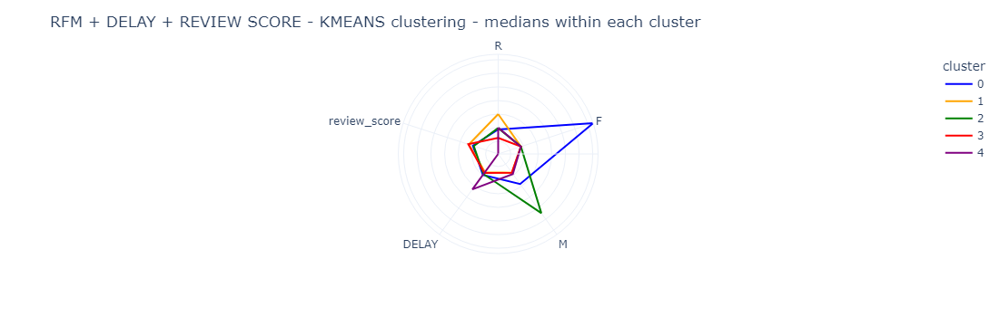

In [81]:
# plot the radar plot with features' means
mf.clusteringRadarPlot(
    df=RFMDR,
    df_scaled=RFMDR_scaled,
    clusters=kmeans_RFMDR_clusters,
    func="mean",
    palette=clusterPalette,
    title="RFM + DELAY + REVIEW SCORE - KMEANS clustering - medians within each cluster",
)

... le '100% stacked' bar plot :

In [82]:
# use exploreClustersWID
mf.exploreClustersWID(
    df=RFMDR_kmeans,
    clusterName="cluster",
    clusteringModelName="Kmeans on RFM + DELAY + REVIEW SCORE",
    palette=clusterPalette,
)

RadioButtons(description='Feature : ', options=('R', 'F', 'M', 'DELAY', 'review_score'), style=DescriptionStyl…

Output()

... et enfin nos distributions par cluster :

In [83]:
mf.plotFeatureVsTargetWID(
    df=RFMDR_kmeans, targetFeatureName="cluster", palette=clusterPalette
)

Dropdown(description='Which column :', options=('R', 'F', 'M', 'DELAY', 'review_score'), style=DescriptionStyl…

IntSlider(value=50, description="Nb of unique values below which a num' feature is considered cat' :", layout=…

Output()

Nous pouvons donc rappeler les clusters initiaux :<br>
<br>
***"dépensiers"***<br>
- *Profil* : Ils n'ont réalisé qu'une seule commande, mais on dépensé en moyenne 700 réals pour celle-ci.<br>
**Profil MAJ : ces clients n'ont pas de particularité spécifique concernant nos 2 nouvelles features `DELAY` et `review_score`.**<br>
- *Potentiel* : Ces clients ont un **potentiel très intéressant** pour l'entreprise car ils n'ont pas peur de dépenser beaucoup sur la plateforme. <br>
- *Objectif* : gagner leur confiance, déclencher une deuxième commande. <br>
- *Actions potentielles* :
    - offrir un (gros) bon d'achat de bienvenue
    - offrir un (gros) cadeau de bienvenue
    - inviter à des "ventes privées" sur des produits à valeur marchande élevée

***"récurrents"***
- *Profil* : Ont réalisé plusieurs commandes. Pour des montants variés.<br>
**Profil MAJ : ces clients n'ont pas de particularité spécifique concernant nos 2 nouvelles features `DELAY` et `review_score`.**<br>
- *Potentiel* : Ces clients **sont déjà les plus intéressants**. Peuvent devenir des fidèles. <br>
- *Objectif* : entretenir la confiance. <br>
- *Actions potentielles* :
    - rechercher leurs catégories de produit préférées
    - inviter à des "ventes privées" sur les catégories de produits les plus achetées
    - proposer un dispositif "fidélité"
 
***"ex-clients"***
- *Profil* : Ils n'ont réalisé qu'une seule commande pour un montant modeste, il y a longtemps.<br>
**Profil MAJ : ces clients n'ont pas de particularité spécifique concernant nos 2 nouvelles features `DELAY` et `review_score`.**<br>
- *Potentiel* : Ces client n'ont pas vraiment de potentiel, car le coût nécessaire pour les ré-intégrer ne sera pas amorti par le montant de la commande. <br>
- *Objectif* : sans objet. Il faut peut-être accepter de perdre ces clients. <br>
- *Actions potentielles* : sans objet

***"nouveaux clients"***
- *Profil* : Ils n'ont réalisé qu'une seule commande pour un montant modeste, mais il y a peu de temps.<br>
**Profil MAJ : ces clients n'ont pas de particularité spécifique concernant nos 2 nouvelles features `DELAY` et `review_score`.**<br>
- *Potentiel* : Ces clients ont du potentiel pour l'entreprise si l'on parvient à déclencher de nouvelles commandes. <br>
- *Objectif* : gagner leur confiance, déclencher une deuxième commande. <br>
- *Actions potentielles* : 
    - offrir un bon d'achat de bienvenue
    - offrir un cadeau de bienvenue
 
Et décrire nos nouveau clusters :<br>
<br>
***"clients mécontents ou ayant subi un retard"***<br>
- *Profil* : Ils ont réalisé une seule commande, commande pour laquelle ils ont subi un **retard** de livraison et/ou ne sont **pas satisfaits**.<br>
- *Potentiel* : Ces clients n'ont pas un gros potentiel pour l'entreprise, car ils sont mécontents (soit parce qu'ils l'ont indiqué en commentaire, soit nous pouvons le supposer fortement car ils ont subi un gros retard de livraison).<br>
- *Objectif* : se faire pardonner, pour déclencher une deuxième commande. <br>
- *Actions potentielles* :
    - comprendre l'origine du mécontentement. Enquète ?
    - proposer un remboursement des frais de livraison sur leur première commande
    - offrir un bon d'achat

# 11) RFMDR + tSNE - Comprendre le manifold

Nous pouvons essayer le `tSNE` sur ce nouveau dataframe. Essayons plusieurs paramètres :

In [84]:
# perplexities to explore
perps = [30, 50, 100, 150, 200, 310]
# exaggerations to explore
exas = [None, 2]
# metrics to explore
metrics = ["euclidean"]

In [85]:
%%time
# save tSNE tests in a dictionnary
if "RFMDR_tsne_Dict.joblib" not in os.listdir("mySaves/reductions") or (
    rapidProcessing == False
):
    # create dictionnary
    RFMDR_tsne_Dict = {}
    # iterate on perplexities, exaggerations and metrics
    for perp in perps:
        for exa in exas:
            for met in metrics:
                # apply parameters to or pipeline
                pipeOpen.set_params(
                    **{
                        "tsne__perplexity": perp,
                        "tsne__metric": met,
                        "tsne__exaggeration": exa,
                    }
                )
                # fit_transform on RFM and put it in a dataframe
                RFMDR_tsne_Dict[str(perp) + "_" + str(exa) + "_" + met] = pd.DataFrame(
                    data=pipeOpen.fit_transform(RFMDR), columns=["C1", "C2"]
                )
    # save
    dump(RFMDR_tsne_Dict, "mySaves/reductions/RFMDR_tsne_Dict.joblib")
else:
    RFMDR_tsne_Dict = load("mySaves/reductions/RFMDR_tsne_Dict.joblib")

CPU times: total: 0 ns
Wall time: 20.5 ms


In [86]:
# display tSNE tests and try KMeans
showMeTsnesAndKmeansWID(RFMDR_tsne_Dict, clusterPalette)

Output()

Le comportement est assez similaire. Testons différents modèles de clustering pour voir si les résultats sont eux aussi décevants :

# 12) RFMDR + tSNE (`perplexity`= 100 / `exaggeration`=None) + KMeans

Testons `KMeans`. Tout d'abord nous pouvons extraire le dataframe du dictionnaire :

In [87]:
# extract the dataframe with perplexity 100, euclidean metric and exaggeration None
RFMDR_tsne = RFMDR_tsne_Dict["100_None_euclidean"].copy()

# scale it
scaler = StandardScaler()
RFMDR_tsne_scaled = pd.DataFrame(
    scaler.fit_transform(RFMDR_tsne), columns=RFMDR_tsne.columns
)

Regardons ce que cela donne au niveau des métriques :

CPU times: total: 15.6 ms
Wall time: 62 ms


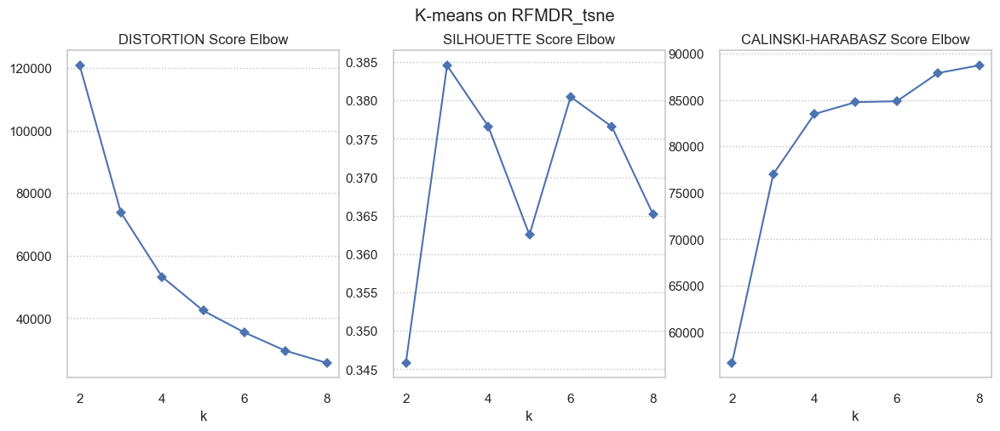

In [88]:
%%time
if "elbowViz_RFMDR_tsne_kmeans.joblib" not in os.listdir("mySaves/elbowViz") or (
    rapidProcessing == False
):
    elbowViz_RFMDR_tsne_kmeans = mf.myElbowVisualizer(
        model=KMeans(n_init=15),
        kRange=(2, 8),
        df=RFMDR_tsne_scaled,
        modelName="K-means on RFMDR_tsne",
    )

    dump(
        elbowViz_RFMDR_tsne_kmeans, "mySaves/elbowViz/elbowViz_RFMDR_tsne_kmeans.joblib"
    )

else:
    elbowViz_RFMDR_tsne_kmeans = load(
        "mySaves/elbowViz/elbowViz_RFMDR_tsne_kmeans.joblib"
    )

Il n'y a pas vraiment de `n_clusters` qui se distingue, néanmoins nous pouvons observer un rebond du coefficient de silhouette moyen pour k = 6. 

In [89]:
# create a model with selected number of clusters
kmeans_RFMDR_tsne = KMeans(n_init=15, n_clusters=6)
# fit on RFMDR_tsne_scaled
kmeans_RFMDR_tsne.fit(RFMDR_tsne_scaled)
# extract cluster labels avec put them in a Series
kmeans_RFMDR_tsne_clusters = kmeans_RFMDR_tsne.predict(RFMDR_tsne_scaled)
kmeans_RFMDR_tsne_clusters = pd.Categorical(kmeans_RFMDR_tsne_clusters)
kmeans_RFMDR_tsne_clusters = pd.Series(kmeans_RFMDR_tsne_clusters, name="cluster")
# add to RFMDR_tsne_scaled
RFMDR_tsne_scaled_kmeans = pd.concat(
    [RFMDR_tsne_scaled, kmeans_RFMDR_tsne_clusters], axis=1
)
# add to RFMDR
RFMDR_kmeans_tnse = pd.concat([RFMDR, kmeans_RFMDR_tsne_clusters], axis=1)

Regardons ce que cela donne sur les différentes paires de dimensions :

In [90]:
# plot pairgrid
mf.clusters_plotPairGrid_WID(
    RFMDR_kmeans_tnse,
    palette=clusterPalette,
    title="t-SNE on RFM + DELAY + REVIEW SCORE and KMeans",
)

Output()

Et sur le radar plot :

C:\Users\cleme\anaconda3\envs\envProject5\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



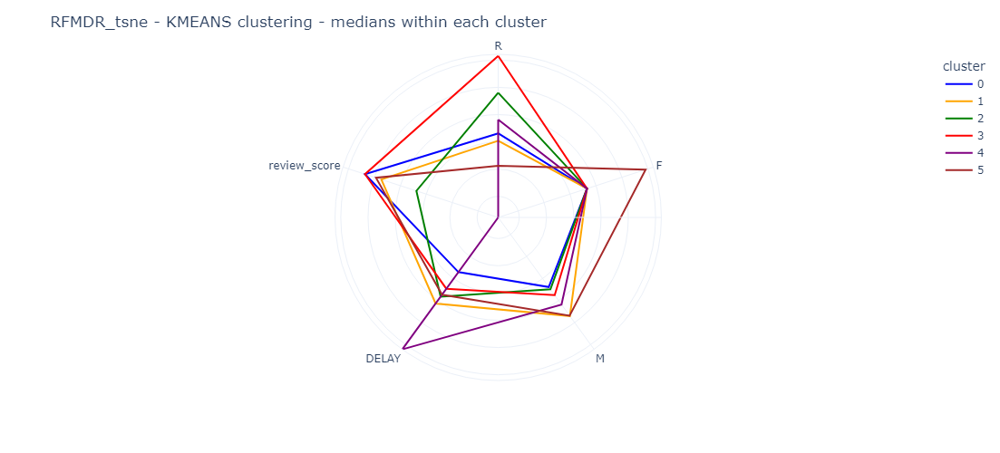

In [91]:
mf.clusteringRadarPlot(
    df=RFMDR,
    df_scaled=RFMDR_scaled,
    clusters=kmeans_RFMDR_tsne_clusters,
    func="mean",
    palette=clusterPalette,
    title="RFMDR_tsne - KMEANS clustering - medians within each cluster",
)

Nous n'irons pas plus loin dans l'interprétation de ce clustering :
- nous retrouvons bien des clusters **"clients non satisfaits ayant eu un problème de livraison"**, **"récurrents"** et **ex-clients**
- mais les **autres clusters ne discriminent pas vraiment les clients**
- la `recense` et le `delay` prennent le dessus sur le `montant`, ce qui en soit n'est pas un problème, mais **les clusters ainsi créés n'apportent pas vraiment d'information**.

Testons tout de même comme précédemment le `DBSCAN` avec des paramètres `tSNE` favorisant la mise en exergue de groupes : 

# 13) RFMDR + tSNE (`perplexity`=200 / `exaggeration`=2) + DBSCAN

Ressortons le dataframe du dictionnaire :

In [92]:
RFMDR_200_2 = RFMDR_tsne_Dict["200_2_euclidean"].copy()
RFMDR_200_2_scaled = pd.DataFrame(
    scaler.fit_transform(RFMDR_200_2), columns=RFMDR_200_2.columns
)

In [93]:
mf.plot_scaling_and_DBSCAN_2D_WID(dataframe=RFMDR_200_2, palette=clusterPalette)

Output()

Ce que l'on peut en retenir :
- un **`nmin` trop élevé** à tendance à classer en **"bruit" le petit groupes** du haut.
- Nous **ne trouvons pas** de réglage de `epsilon` et `nmin` **permettant de capturer les clients isolés sous la forme de droite placée au centre tout en laissant les clients de la forme centrale séparés de ceux de la forme de gauche**...

Il n'y a pas vraiment de combinaison intéressante. Utilisons les paramètres esp = 0.13 et nmin = 200, **qui générent certes beaucoup de clusters, mais qui permettra de voir si les clusters générés par tSNE sont intéressants.**

In [94]:
# create a model with selected eps and nmin
db_DR_tsne = DBSCAN(eps=0.13, min_samples=200, n_jobs=14)
# fit_predict on RFM_tsne_scaled and put these labels in a Series
db_DR_tsne_clusters = db_DR_tsne.fit_predict(RFMDR_200_2_scaled)
db_DR_tsne_clusters = pd.Categorical(db_DR_tsne_clusters)
db_DR_tsne_clusters = pd.Series(db_DR_tsne_clusters, name="cluster")
# add to RFMDR_200_2_scaled
RFMDR_200_2_scaled_dbscan = pd.concat([RFMDR_200_2_scaled, db_DR_tsne_clusters], axis=1)
# add to RFMDR
RFMDR_dbscan = pd.concat([RFMDR, db_DR_tsne_clusters], axis=1)

Regardons ce que cela donne :

In [95]:
# plot pairgrid
mf.clusters_plotPairGrid_WID(
    RFMDR_dbscan,
    palette=clusterPalette,
    title="t-SNE on RFM + DELAY + REVIEW SCORE, then DBSCAN",
)

Output()

Ce que l'on peut en retenir :
- les clients **récurrents** ont été séparés **en 2**, entre `F` = 2 et `F` > 2
- nous avons **un cluster avec les gros retards de livraison**
- un autre avec les **mauvaises notes**
- un cluster avec les clients **très récents**
- un avec des **notes à 3**
- un avec des **notes à 4**
- un avec des notes **majoritairement à 5 mais aussi à 4 si le montant de la commande est élevé**.

Ce clustering n'est pas très intéressant...

# CONCLUSION

Nous avons pu tester différents modèles de clustering sur nos données, tout d'abord dans le cadre d'une segmentation classique `RFM`, puis en ajoutant d'**autres features `DELAY`** et **`review_score`** qui ont permis d'**améliorer** notre segmentation.

Nous avons **tenté de déterminer le manifold de nos données**, mais même en utilisant des paramètres favorisant la création de clusters, couplés avec un algorithme de clustering à densité `DBSCAN`, et ainsi **bien capturer les clusters mis en exergue dans l'espace de redistribution**, il s'est avéré que les **clusters en question n'étaient pas les plus pertinents** d'un point de vue strictement marketing.

L'utilisation du `t-SNE` soulèverait d'autre problèmes :
- son caractère **aléatoire** ne permettrait pas d'obtenir une bonne **stabilité** dans le temps,
- l'**utilisation d'une projection existente, par exemple d'une journée à l'autre, ne se fait pas aisément** : la librairie `sklearn` ne le permet pas par exemple. Cela obligerait à entraîner un nouveau modèle à chaque fois, **ce qui s'apparente plus à de la maintenance** qu'à une utilisation libre et facile d'une segmentation déjà existente.

Des trois modèles testés, le **`KMeans` s'est avéré le plus pertinent** :
- `DBSCAN` :
    - ne peut pas identifier de gap de densité dans le gros de données : **les clients avec 1 seule commande**
    - de plus **les clusters à créer n'ont pas de formes particulières/concaves**,
    - sauf à utiliser le `tSNE` d'une certaine manière. Mais, encore une fois, les groupes ainsi constitués n'ont eu pas vraiment d'intérêt...
- `clustering hiérarchique` :
    - les clusters déterminés sont **pertinents**
    - mais l'**espace mémoire** nécessaire est trop important pour faire tourner l'algorithme... sans parler du **temps de calcul**...
- `KMeans` :
    - algorithme **rapide**
    - les clusters déterminés sont **interprétables et pertinents** pour mettre en place une stratégie markéting ciblée

**La solution proposée** :

- Variables :
    - `RÉCENSE`
    - `FRÉQUENCE`
    - `MONTANT`
    - `ÉCART DATE LIVRAISON PRÉVUE/RÉELLE`
    - `NOTE CLIENT`
- Modèle : `KMeans`
- Segments :
    - *dépensiers*
    - *récurrents*
    - *ex-clients*
    - *nouveaux clients*
    - *clients insatisfaits*

In [96]:
# compute execution time
end_time = time.time()
print("execution time :", int((end_time - start_time) / 60), "min.")

execution time : 2 min.
